<a href="https://colab.research.google.com/github/varun1724/NUCLS-Image-Segmentation/blob/main/Mask_RCNN_Multi_Class_TF1x_Testing_Only.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# !cp /content/drive/MyDrive/maskrcnn/mask_rcnn_coco.h5 /content

In [ ]:
!pip install tensorflow==1.14
!pip install tensorflow-gpu==1.14
!pip install keras==2.1
!pip install 'h5py==2.10.0' --force-reinstall

In [ ]:
!git clone -q https://github.com/matterport/Mask_RCNN.git

In [ ]:
!cp -r /content/drive/MyDrive/maskrcnn/Mask_RCNN /content/

In [ ]:
!pip install ipyparallel

!Restart Runtime

In [ ]:
import os
import glob
import cv2
import pandas as pd
import xml.etree
from numpy import zeros, asarray

import Mask_RCNN.mrcnn.utils
import Mask_RCNN.mrcnn.config
import Mask_RCNN.mrcnn.model
# import Mask_RCNN.mrcnn.util
# import Mask_RCNN.mrcnn.loss_layers

# from Mask_RCNN.mrcnn.loss_layers import precision_at_recall_loss
# from Mask_RCNN.mrcnn.loss_layers import roc_auc_loss
# from Mask_RCNN.mrcnn.loss_layers import precision_recall_auc_loss
# from Mask_RCNN.mrcnn.loss_layers import recall_at_precision_loss


class NuCLSDataset(Mask_RCNN.mrcnn.utils.Dataset):

	def load_dataset(self, dataset_dir, fold_num, is_train=True):
		self.add_class("dataset", 1, "Tumor")
		self.add_class("dataset", 2, "Mitotic_f")
		self.add_class("dataset", 3, "Stromal")
		self.add_class("dataset", 4, "Macroph")
		self.add_class("dataset", 5, "Lymphoc")
		self.add_class("dataset", 6, "Plasma C")
		self.add_class("dataset", 7, "Other")

		# class_names_list = ['Tuomr', 'Mitotic_f', 'Stromal', 'Macroph', 'Lymphoc', 
    #                   'apoptotic_body', 'plasma_cell', 'macrophage', 
    #                   'correction_fibroblast', 'correction_lymphocyte', 
    #                   'correction_tumor', 'correction_plasma_cell', 
    #                   'ductal_epithelium', 'myoepithelium', 
    #                   'correction_apoptotic_body', 'correction_unlabeled', 
    #                   'eosinophil', 'correction_macrophage', 
    #                   'correction_mitotic_figure']

		images_dir = dataset_dir + '/train_test_splits'
		annotations_dir = dataset_dir + '/csv/'

		if is_train:
		  fold_file = images_dir + '/fold_' + str(fold_num) + '_train.csv'
		else:
		  fold_file = images_dir + '/fold_' + str(fold_num) + '_test.csv'

		df = pd.DataFrame()
		df = pd.read_csv(fold_file)

		image_file_path = dataset_dir + '/rgb/'

		for i in range(len(df)):
      
			images_paths = glob.glob(image_file_path + str(df.loc[i,'slide_name']) + '*')

			for img_path in images_paths:

				image_id = img_path[len(img_path):][:-4] #filename[:-4]

				mask_path = img_path.replace('/QC/rgb/','/QC/mask/')
				ann_path = img_path.replace('/QC/rgb/','/QC/csv/')
				ann_path = ann_path.replace('.png','.csv')
				im = cv2.imread(img_path)
				h, w, c = im.shape
				df1 = pd.DataFrame()
				df1 = pd.read_csv(ann_path)
				img_write = False
				for i in range(len(df1)):
					class_name = df1.loc[i,'group']
					if not class_name in ['apoptotic_body', 'correction_apoptotic_body', 
                           'unlabeled', 'correction_unlabeled']:
						img_write = True
						break
						# if not class_name in class_names_list:
						# 	class_names_list += [class_name]
						# 	print(class_names_list)
			  # ann_path = annotations_dir + image_id + '.xml'

				if img_write:
					self.add_image('dataset', image_id=image_id, path=img_path, annotation=ann_path, h=h, w=w)

	def extract_boxes(self, filename, width, height):
   
		class_list1 = ['tumor', 'correction_tumor']
		class_list2 = ['mitotic_figure', 'correction_mitotic_figure']
		class_list3 = ['fibroblast', 'correction_fibroblast',
										'vascular_endothelium', 'correction_vascular_endothelium']
		class_list4 = ['macrophage', 'correction_macrophage']
		class_list5 = ['lymphocyte', 'correction_lymphocyte']
		class_list6 = ['plasma_cell', 'correction_plasma_cell']
		class_list7 = ['neutrophil', 'correction_neutrophil',
										'eosinophil', 'correction_eosinophil',
										'myoepithelium', 'correction_myoepithelium',
										'ductal_epithelium', 'correction_ductal_epithelium']

		df = pd.DataFrame()
		df = pd.read_csv(filename)

		boxes = list()
		class_ids = list()

		for i in range(len(df)):
			class_name = df.loc[i,'group']
			if not class_name in ['apoptotic_body', 'correction_apoptotic_body', 
                           'unlabeled', 'correction_unlabeled']:
				xmin = int(df.loc[i,'xmin'])
				ymin = int(df.loc[i,'ymin'])
				xmax = int(df.loc[i,'xmax'])
				ymax = int(df.loc[i,'ymax'])
				coors = [xmin, ymin, xmax, ymax]
				# print(class_name)
				if class_name in class_list1:
					id = 1
				if class_name in class_list2:
					id = 2
				if class_name in class_list3:
					id = 3
				if class_name in class_list4:
					id = 4
				if class_name in class_list5:
					id = 5
				if class_name in class_list6:
					id = 6
				if class_name in class_list7:
					id = 7
				boxes.append(coors)
				class_ids.append(id)

		# print(boxes, width, height)
		# print(class_ids)
		return boxes, width, height, class_ids

	def load_mask(self, image_id):
		info = self.image_info[image_id]
		path = info['annotation']
		width = info['w']
		height = info['h']
		boxes, w, h, class_ids = self.extract_boxes(path, width, height)
		masks = zeros([h, w, len(boxes)], dtype='uint8')
		# print(class_ids)

		# class_ids = list()
		for i in range(len(boxes)):
			box = boxes[i]
			row_s, row_e = box[1], box[3]
			col_s, col_e = box[0], box[2]
			masks[row_s:row_e, col_s:col_e, i] = 1
			# class_ids.append(self.class_names.index('tumor'))
		# print(masks, asarray(class_ids, dtype='int32'))
		return masks, asarray(class_ids, dtype='int32')

In [ ]:
class TestConfig(Mask_RCNN.mrcnn.config.Config):
    NAME = "Test_cfg"

    GPU_COUNT = 1
    IMAGES_PER_GPU = 1
    
    NUM_CLASSES = 7+1


Test_config = TestConfig()
Test_config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                20
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE         

In [ ]:
model = Mask_RCNN.mrcnn.model.MaskRCNN(mode='inference', 
                          model_dir='/content/', 
                          config=Test_config)

model.keras_model.load_weights(filepath='/content/drive/MyDrive/maskrcnn/NuCLS_mask_rcnn_mclass_r2.h5', 
                  by_name=True)

In [ ]:
from numpy import expand_dims
from numpy import mean
from Mask_RCNN.mrcnn.model import load_image_gt
from Mask_RCNN.mrcnn.utils import compute_ap_range
from Mask_RCNN.mrcnn.utils import compute_ap
from Mask_RCNN.mrcnn.utils import compute_matches
from Mask_RCNN.mrcnn.utils import compute_recall

from Mask_RCNN.mrcnn.model import mold_image

from matplotlib import pyplot
from matplotlib.patches import Rectangle
import numpy as np
import Mask_RCNN.mrcnn.visualize as visualize
import Mask_RCNN.mrcnn.utils as utils
from Mask_RCNN.mrcnn.model import log

In [ ]:
def evaluate_model_1(dataset, model, cfg):
  APs = list(); ARs = list(); APRs = list()
  for image_id in dataset.image_ids:
    image, image_meta, gt_class_id, gt_bbox, gt_mask = load_image_gt(dataset, cfg, image_id, use_mini_mask=False)
    # Run detection
    results = model.detect([image], verbose=0)

    # Visualize results
    r = results[0]
    AP, _, _, _ = compute_ap(gt_bbox, gt_class_id, gt_mask, r["rois"], r["class_ids"], r["scores"], r['masks'])
    APR = compute_ap_range(gt_bbox, gt_class_id, gt_mask, r["rois"], r["class_ids"], r["scores"], r['masks'], verbose=0)
    AR, _ = compute_recall(r["rois"], gt_bbox, iou=0.5) 
    ARs.append(AR)
    APs.append(AP)
    APRs.append(APR)
  # calculate the mean AP across all images
  mAP = mean(APs)
  mAR = mean(ARs)
  mAPR = mean(APRs) 
  return mAP, mAR, mAPR

**Test Results to Use**

In [ ]:
for folds in range(5):
  print(' fold=',folds+1)

  valid_dataset = NuCLSDataset()
  valid_dataset.load_dataset(dataset_dir='/content/drive/MyDrive/QC', fold_num = int(folds+1), is_train=False)
  valid_dataset.prepare()

  # test_mAP = evaluate_model(valid_dataset, model, Test_config, threshold=0.5)
  # print("Test mAP: %.3f" % test_mAP)

  test_mAP, mARs_test, mAPR_test = evaluate_model_1(valid_dataset, model, Test_config)

  f_score_test = (2 * test_mAP * mARs_test)/(test_mAP + mARs_test)

  print("Test mAP: %.3f" % test_mAP)
  print('f1-score-test: %.3f' % f_score_test)
  print('mAP 0.5:0.95: %.3f' % mAPR_test)

 fold= 1
Test mAP: 0.995
f1-score-test: 0.995
mAP 0.5:0.95: 0.794
 fold= 2
Test mAP: 0.996
f1-score-test: 0.996
mAP 0.5:0.95: 0.799
 fold= 3
Test mAP: 0.994
f1-score-test: 0.994
mAP 0.5:0.95: 0.795
 fold= 4
Test mAP: 0.996
f1-score-test: 0.996
mAP 0.5:0.95: 0.790
 fold= 5
Test mAP: 0.997
f1-score-test: 0.997
mAP 0.5:0.95: 0.802


In [ ]:
dataset = valid_dataset
image_ids = np.random.choice(dataset.image_ids, 1)
for image_id in image_ids:#dataset.image_ids:#
		info = dataset.image_info[image_id]
		img_path = info['path']
		ann_path = info['annotation']
		# load the image and mask
		image = dataset.load_image(image_id)
		mask, class_ids = dataset.load_mask(image_id)
		# Compute Bounding box
		bbox = utils.extract_bboxes(mask)

    # Run detection
		results = model.detect([image], verbose=0)

		# Visualize results
		r = results[0]

		# get matches
		gt_match, pred_match, overlaps = compute_matches(bbox, class_ids, mask, r["rois"], r["class_ids"], r["scores"], r['masks'])
		print(gt_match, pred_match, overlaps)


[0. 1. 2. 3.] [ 0.  1.  2.  3. -1.] [[0.9538905  0.         0.         0.        ]
 [0.         0.9462074  0.         0.        ]
 [0.         0.         0.93048126 0.        ]
 [0.         0.         0.         0.8902299 ]
 [0.         0.         0.         0.        ]]


In [ ]:
# plot a number of photos with ground truth and predictions
def plot_actual_vs_predicted(dataset, model, cfg, n_images=5):
	# load image and mask
	k = 0
	APs = list()
	image_ids = np.random.choice(dataset.image_ids, n_images)
	for image_id in dataset.image_ids:#image_ids:
		info = dataset.image_info[image_id]
		img_path = info['path']
		ann_path = info['annotation']
		# load the image and mask
		image = dataset.load_image(image_id)
		mask, class_ids = dataset.load_mask(image_id)
		# Compute Bounding box
		bbox = utils.extract_bboxes(mask)
    # Display image and additional stats
		# log("image", image)
		# log("mask", mask)
		# log("class_ids", class_ids)
		# log("bbox", bbox)

    # Run detection
		results = model.detect([image], verbose=0)

		# Visualize results
		r = results[0]

		# Display image and instances
		AP, _, _, _ = compute_ap(bbox, class_ids, mask, r["rois"], r["class_ids"], r["scores"], r['masks'])
		APs.append(AP)
		mAP = mean(APs)
		# if AP < 0.95:
			# k += 1
			# print(k,img_path, 'AP = ', AP)#,ann_path)
		print('AP = ', AP)
		print('APs = ', APs)
		print('mAP = ', mAP)
		visualize.display_instances(image, bbox, mask, class_ids, valid_dataset.class_names, show_mask=False)
		visualize.display_differences(image,
                        bbox, class_ids, mask,
                        r['rois'], r['class_ids'], r['scores'], r['masks'],
                        ['tumor'], title="image" + str(image_id), ax=None,
                        show_mask=False, show_box=True,
												iou_threshold=0.5, score_threshold=0.5)
		visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], valid_dataset.class_names, show_mask=False)

AP =  1.0
APs =  [1.0]
mAP =  1.0


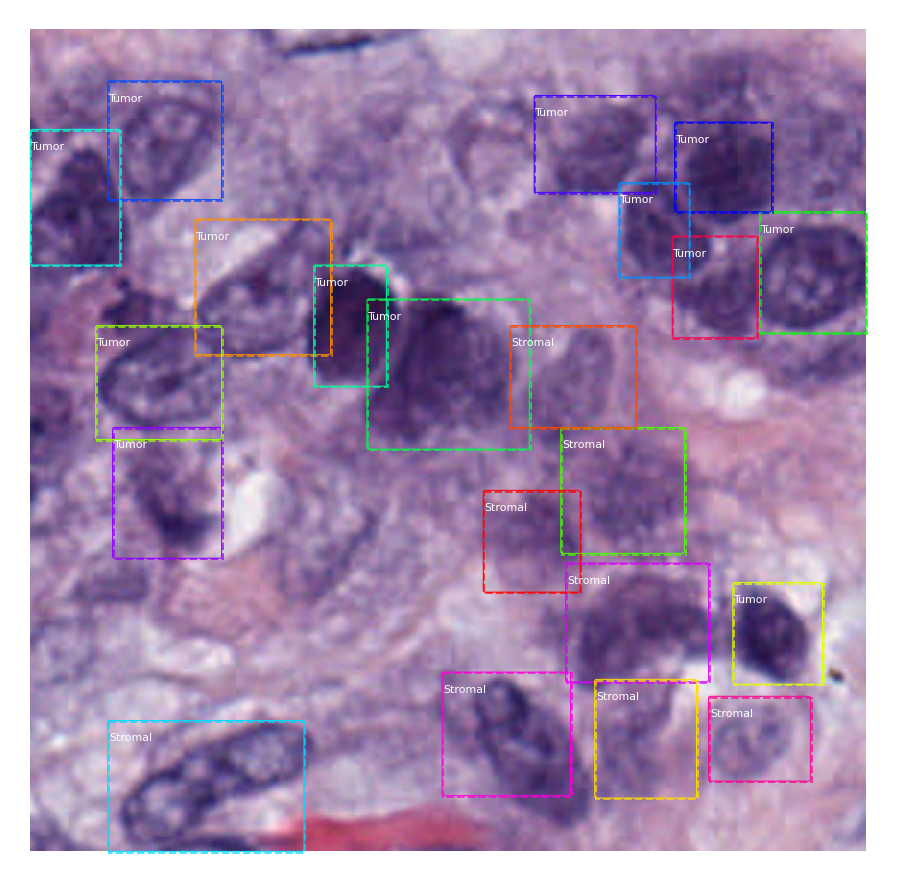

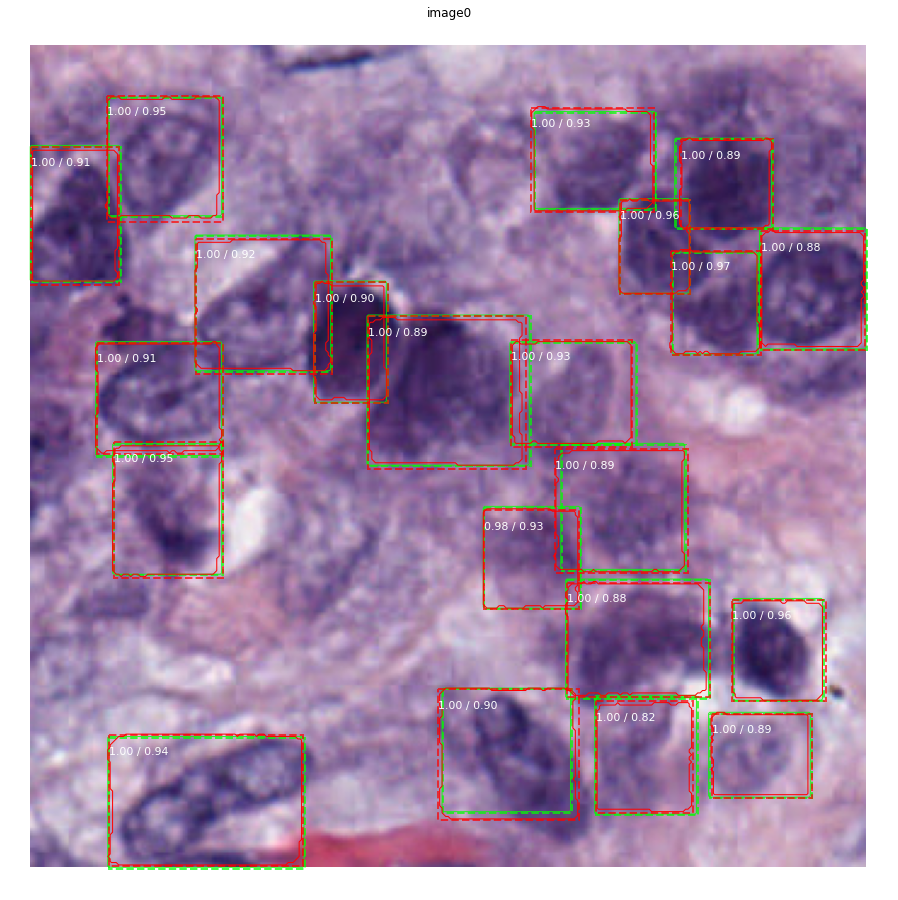

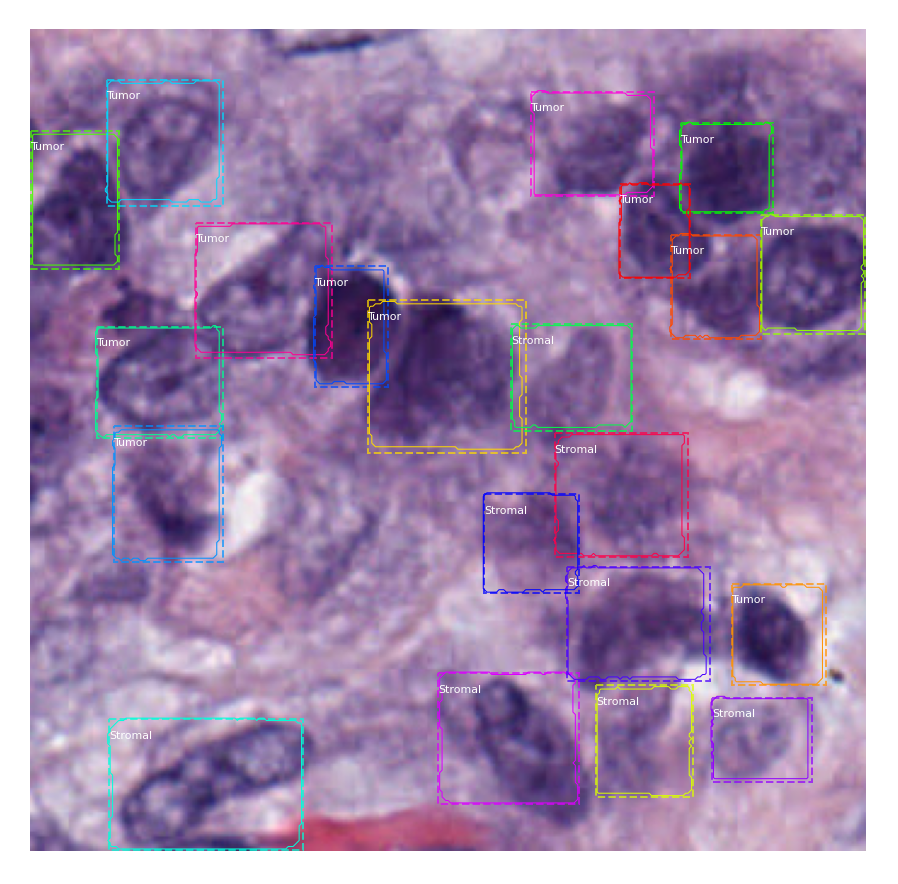

AP =  1.0
APs =  [1.0, 1.0]
mAP =  1.0


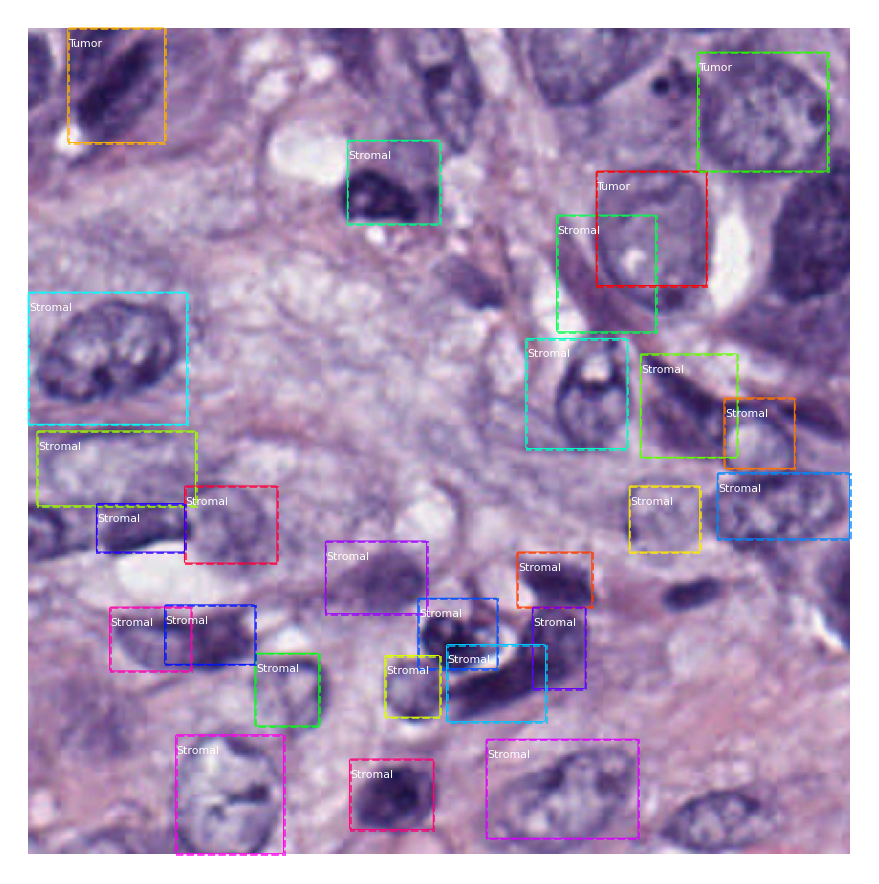

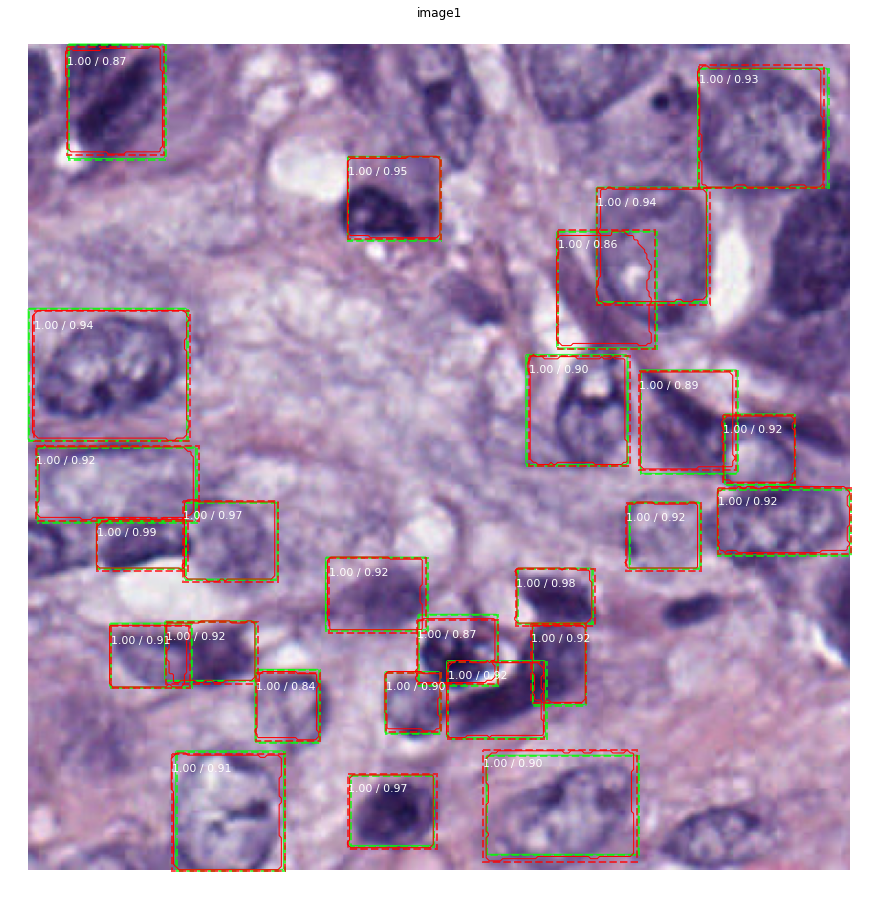

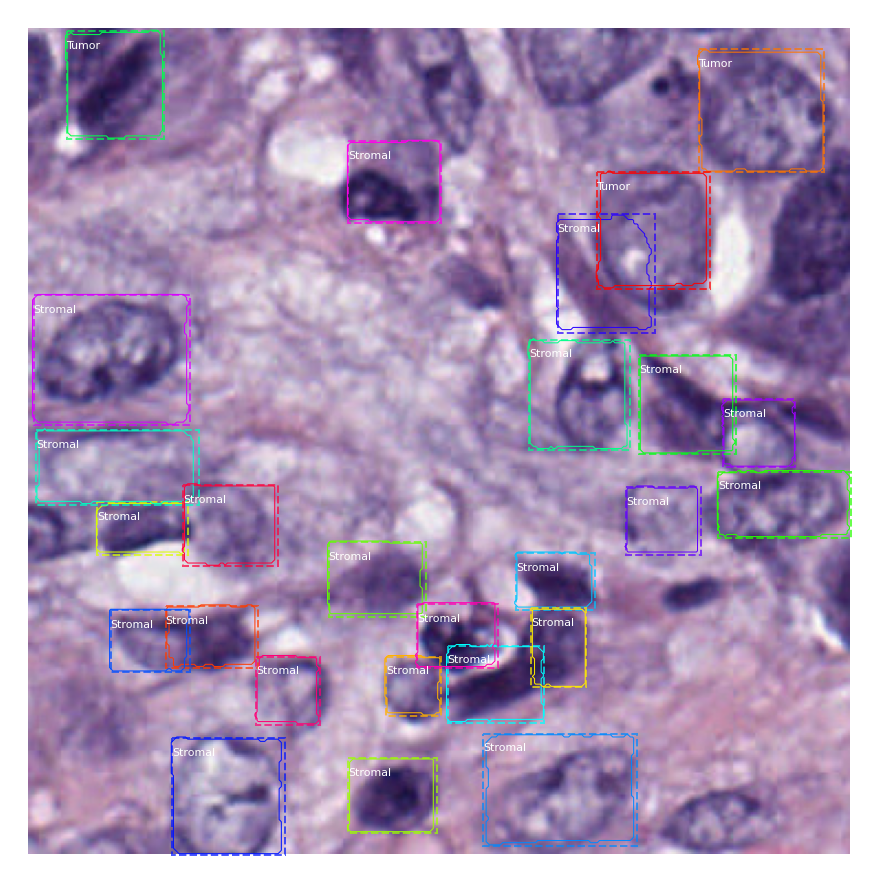

AP =  1.0
APs =  [1.0, 1.0, 1.0]
mAP =  1.0


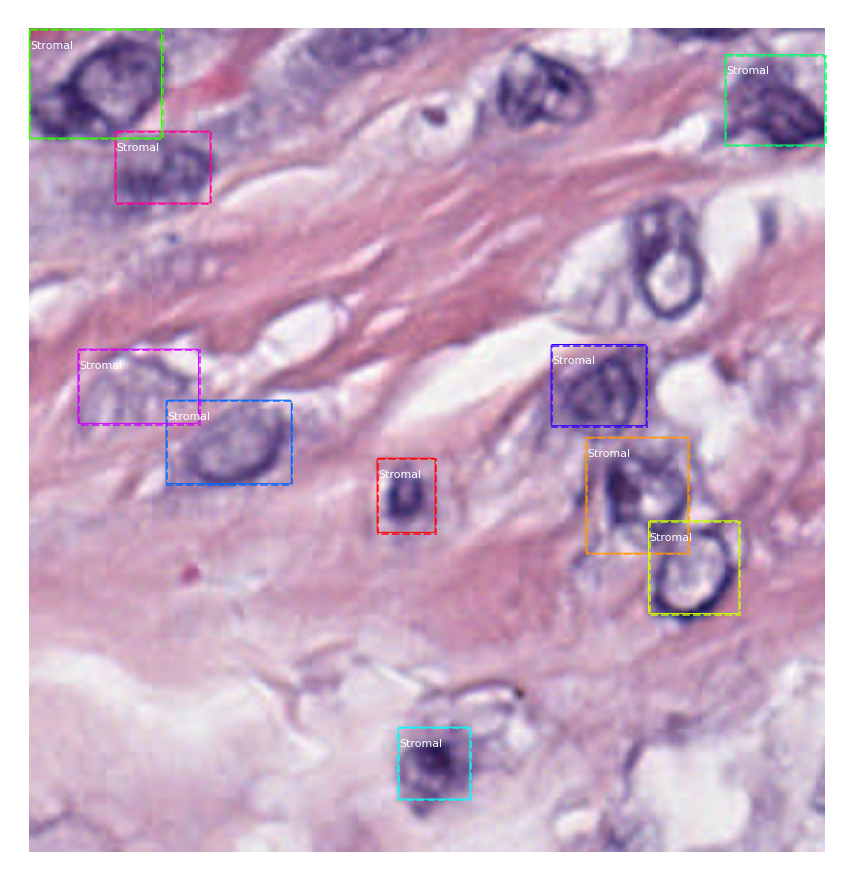

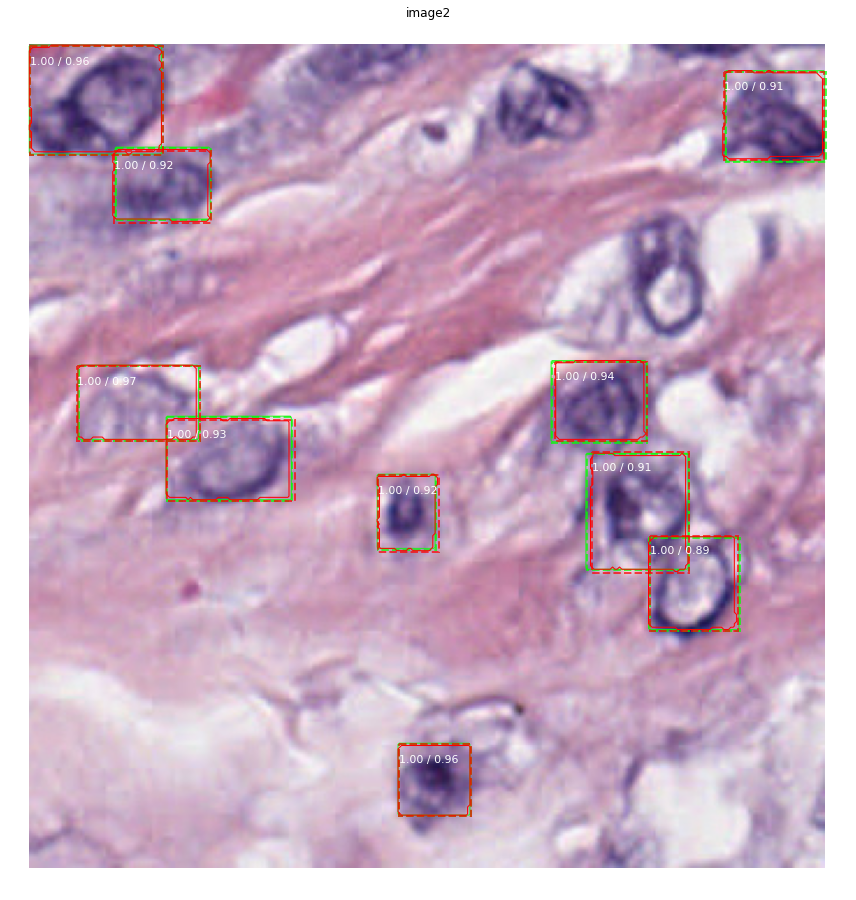

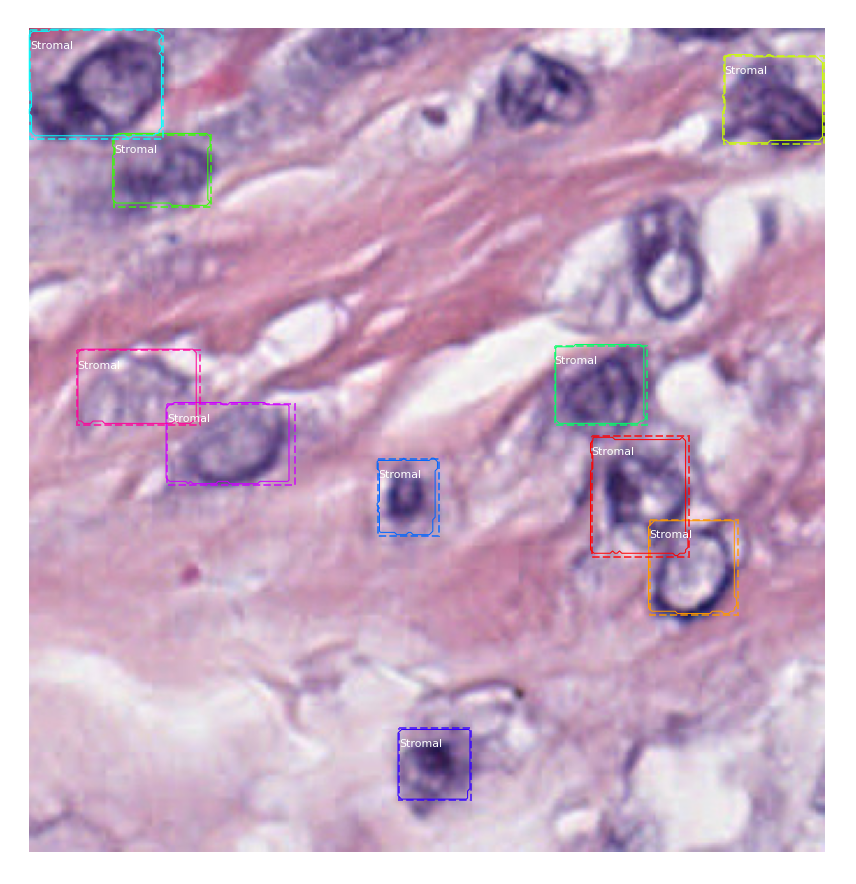

AP =  1.0
APs =  [1.0, 1.0, 1.0, 1.0]
mAP =  1.0


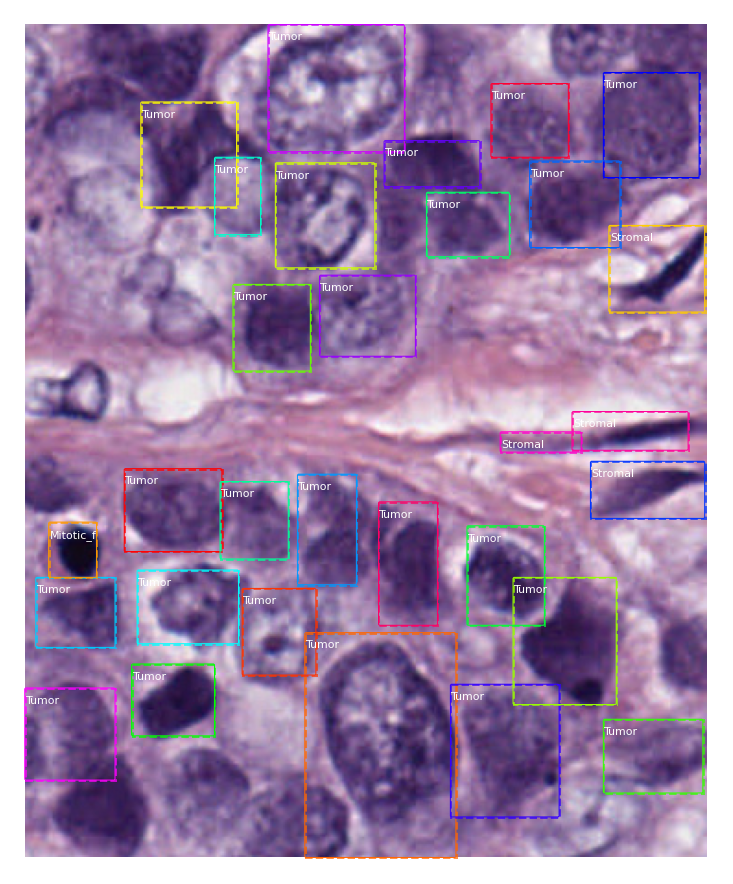

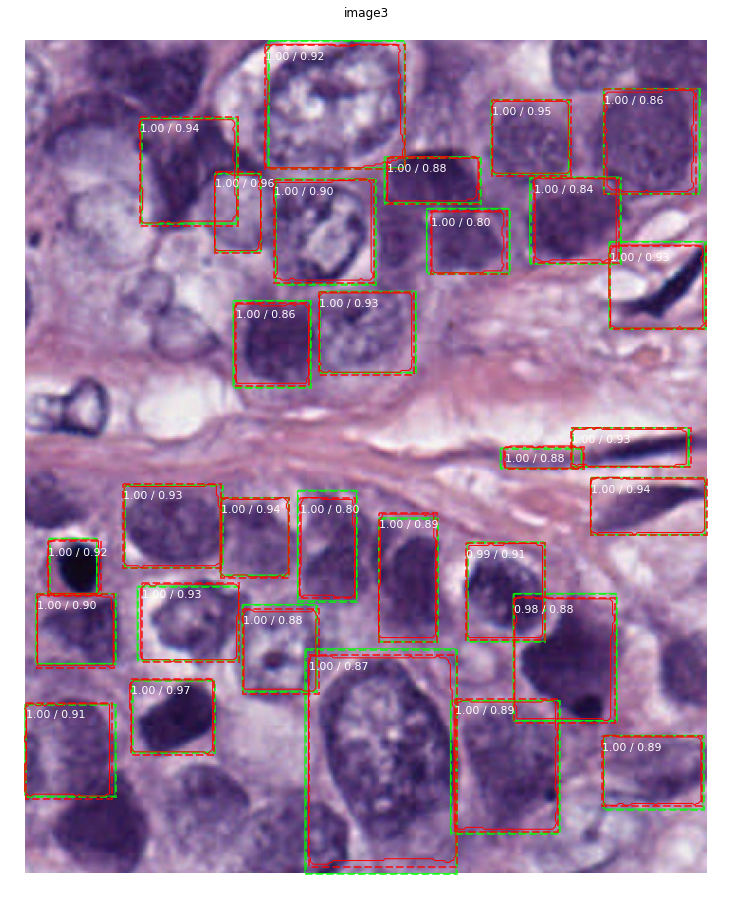

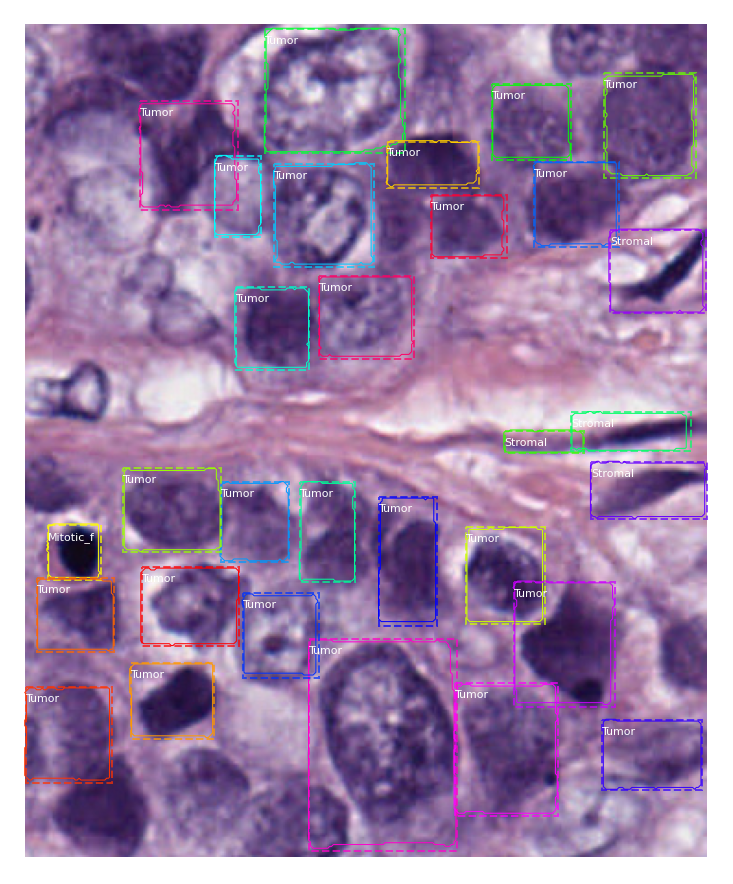

AP =  1.0
APs =  [1.0, 1.0, 1.0, 1.0, 1.0]
mAP =  1.0


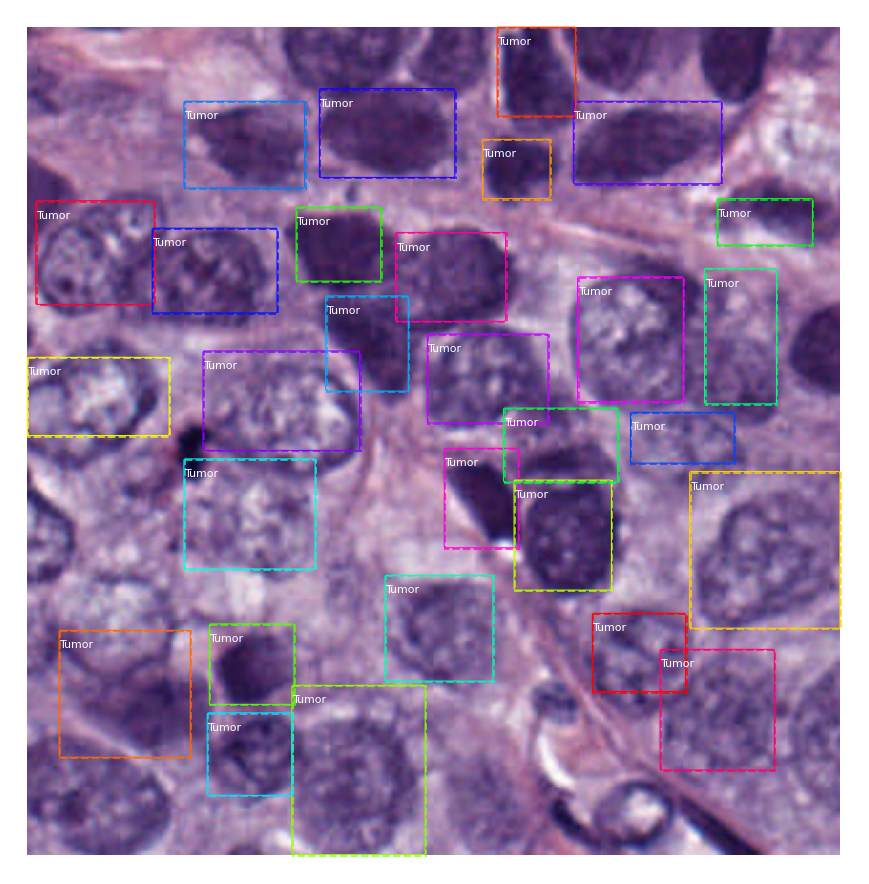

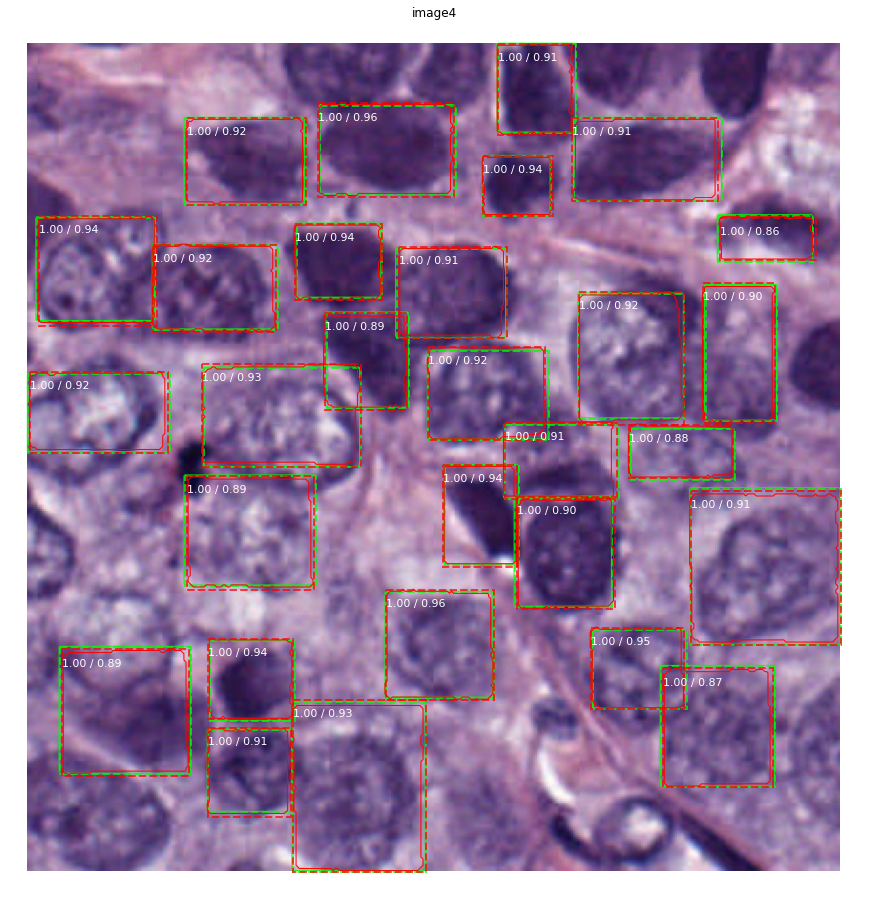

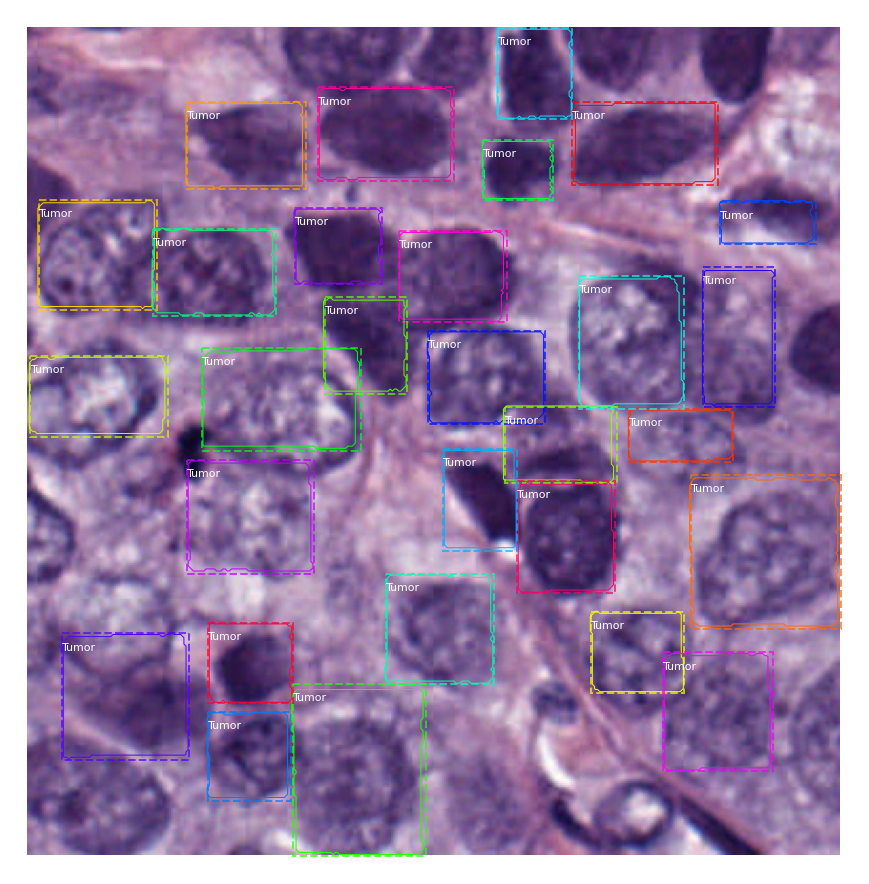

AP =  1.0
APs =  [1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
mAP =  1.0


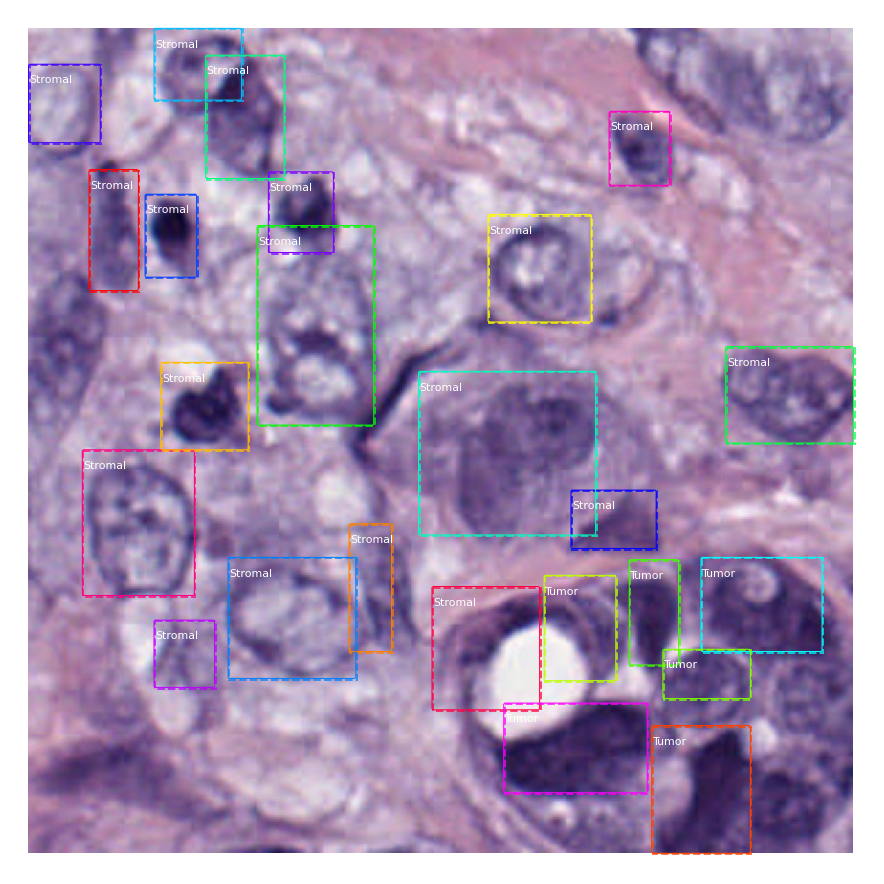

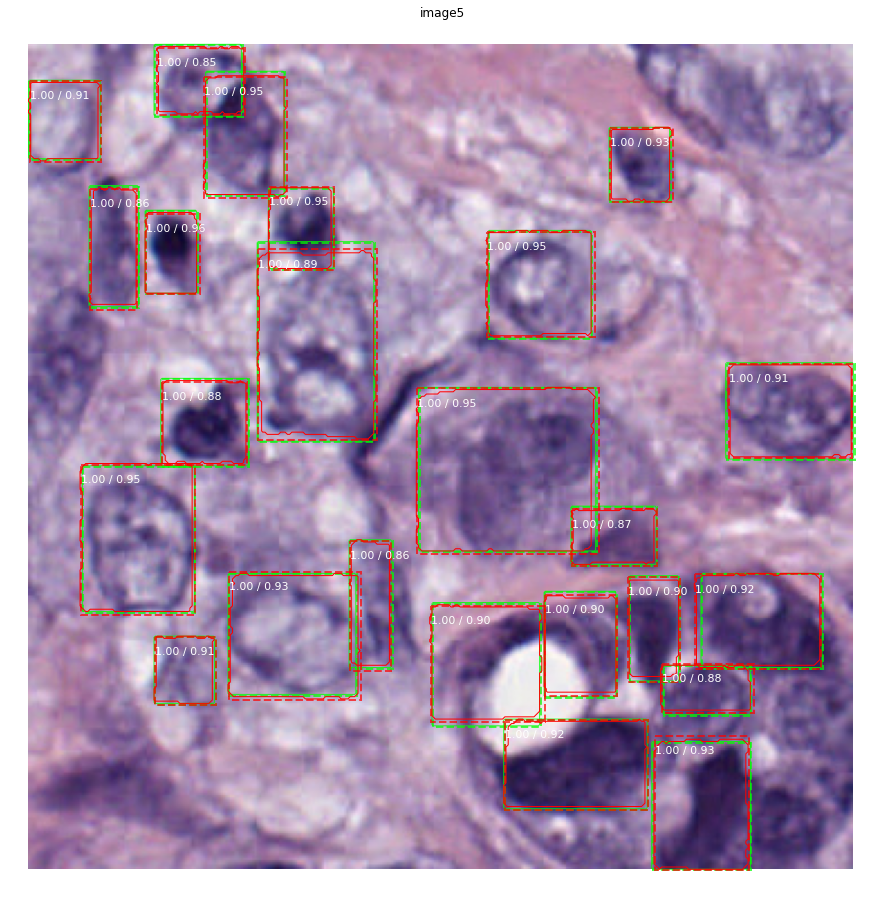

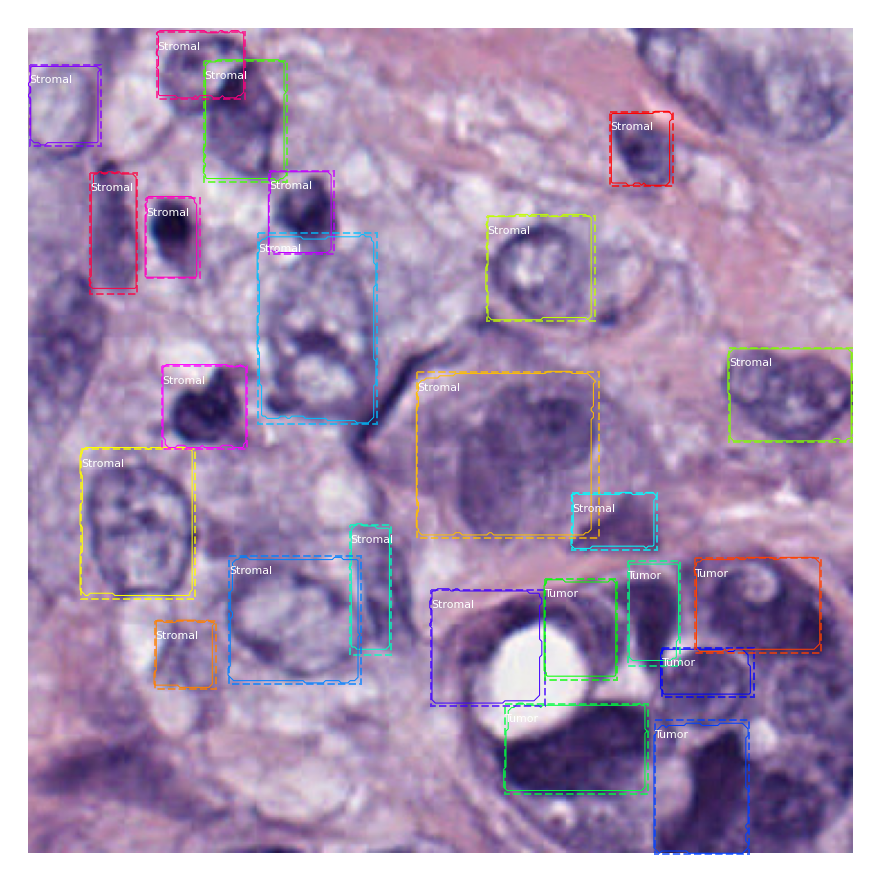

AP =  1.0
APs =  [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
mAP =  1.0


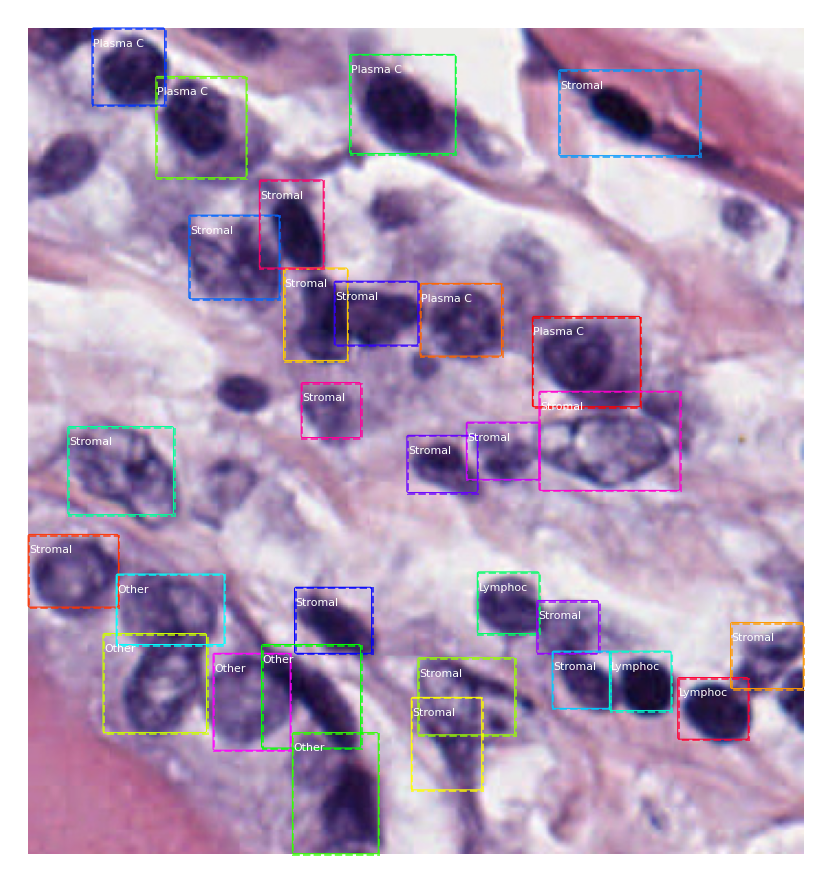

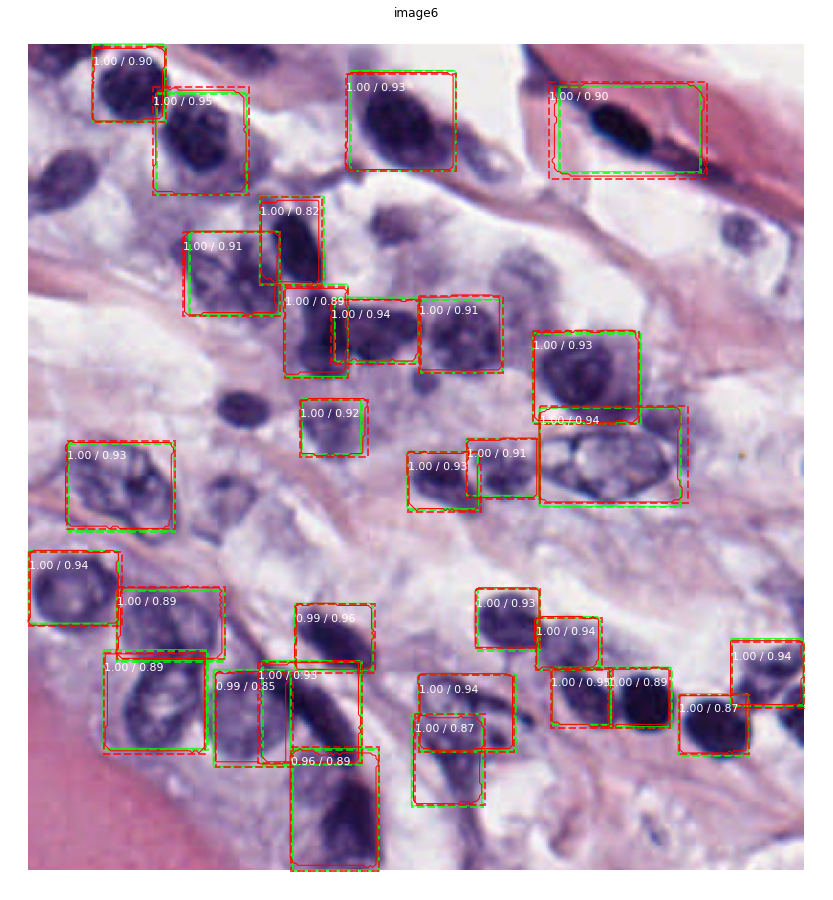

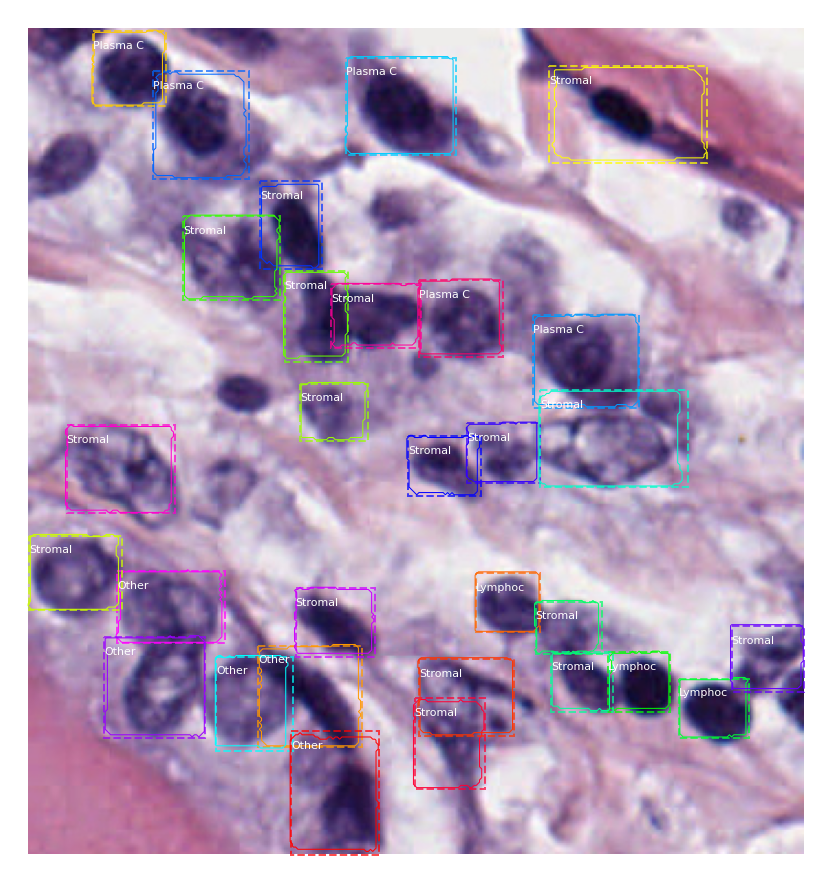

AP =  1.0
APs =  [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
mAP =  1.0


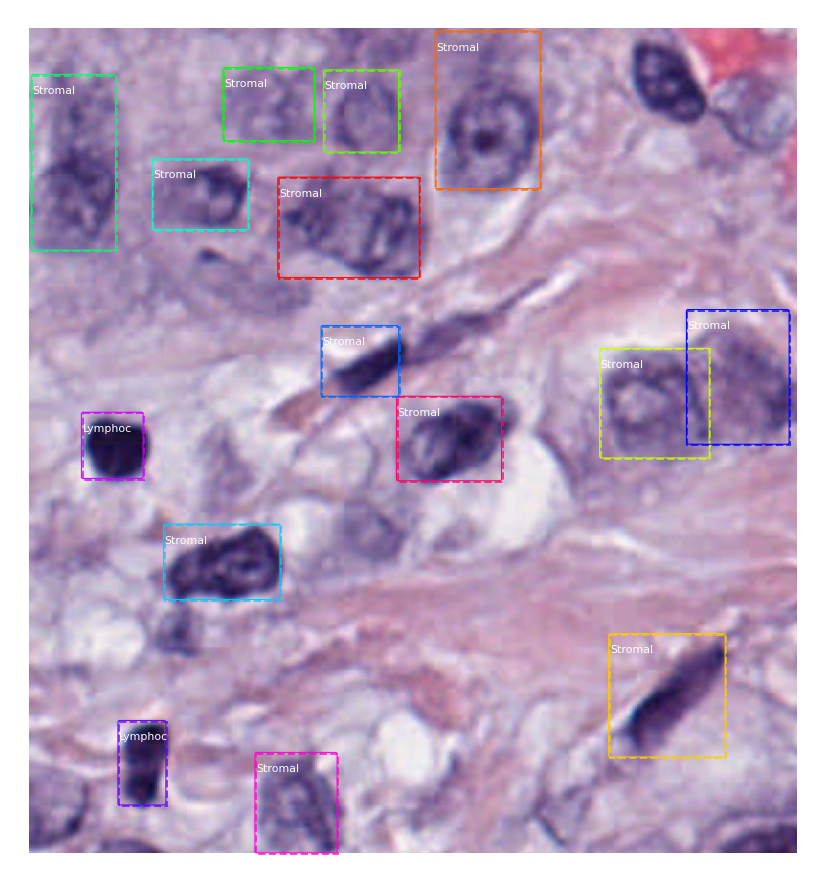

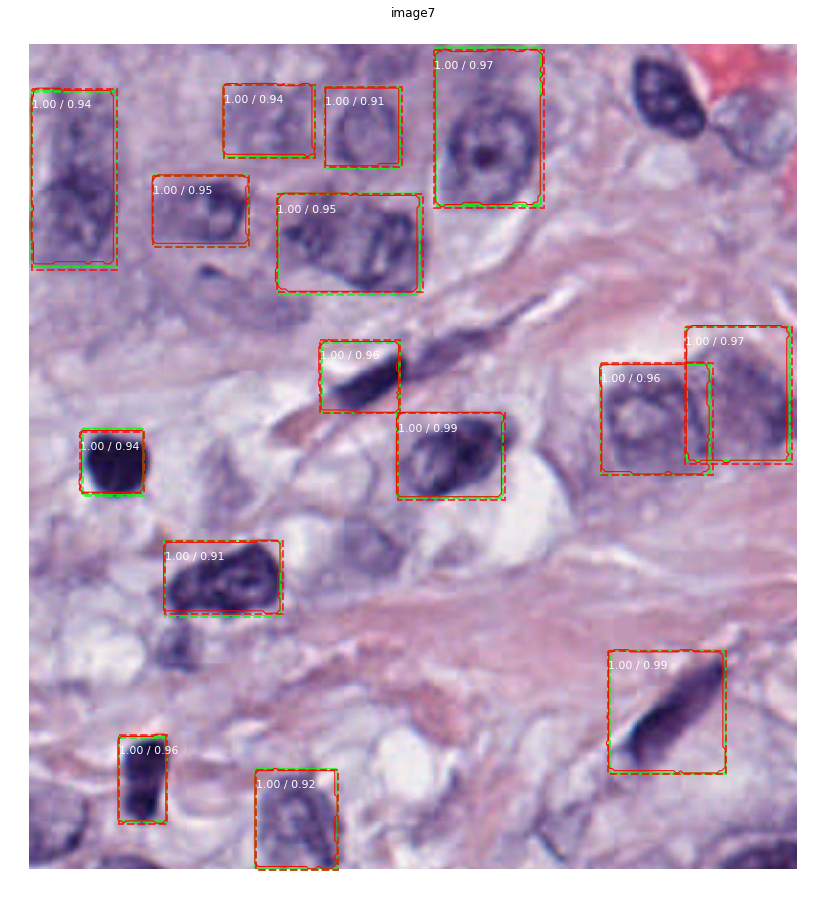

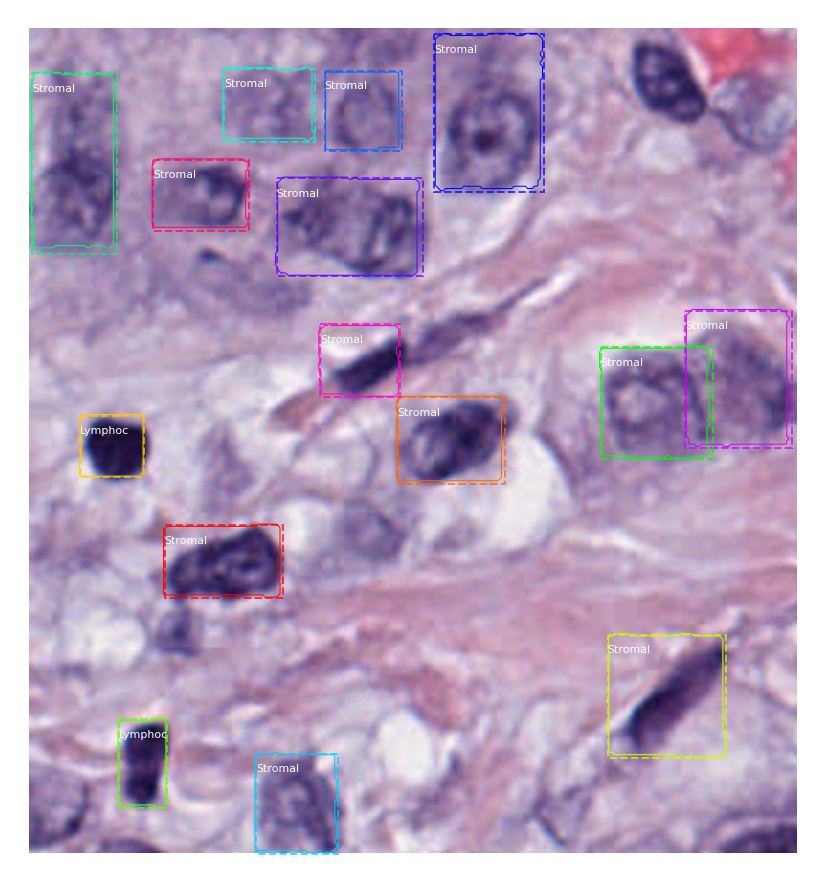

AP =  1.0
APs =  [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
mAP =  1.0


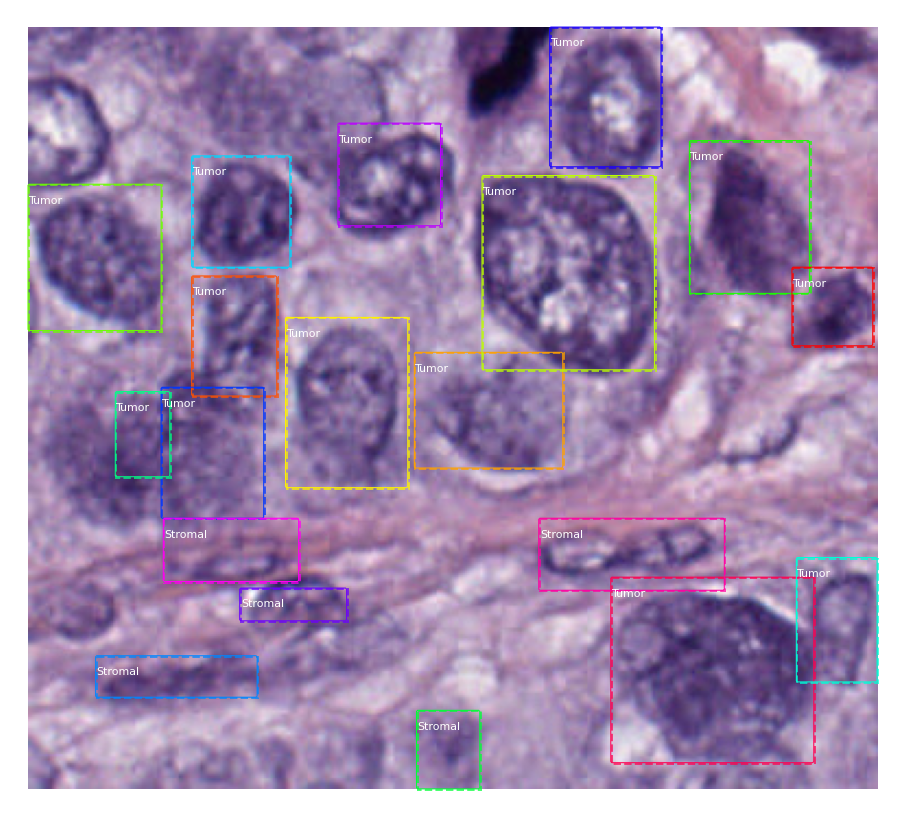

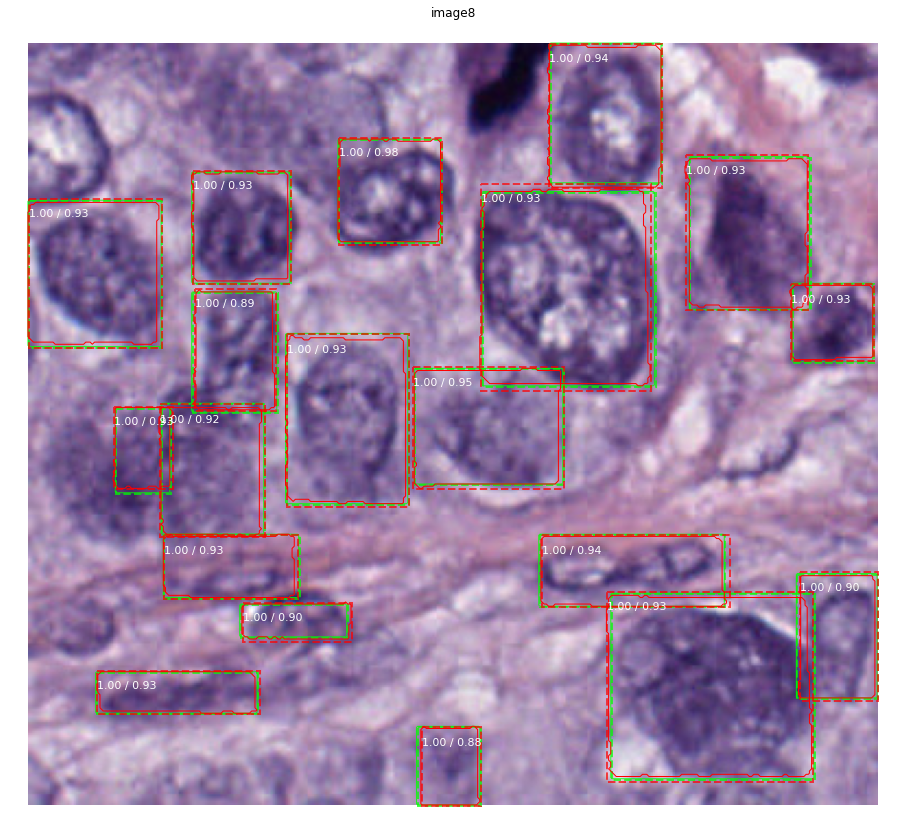

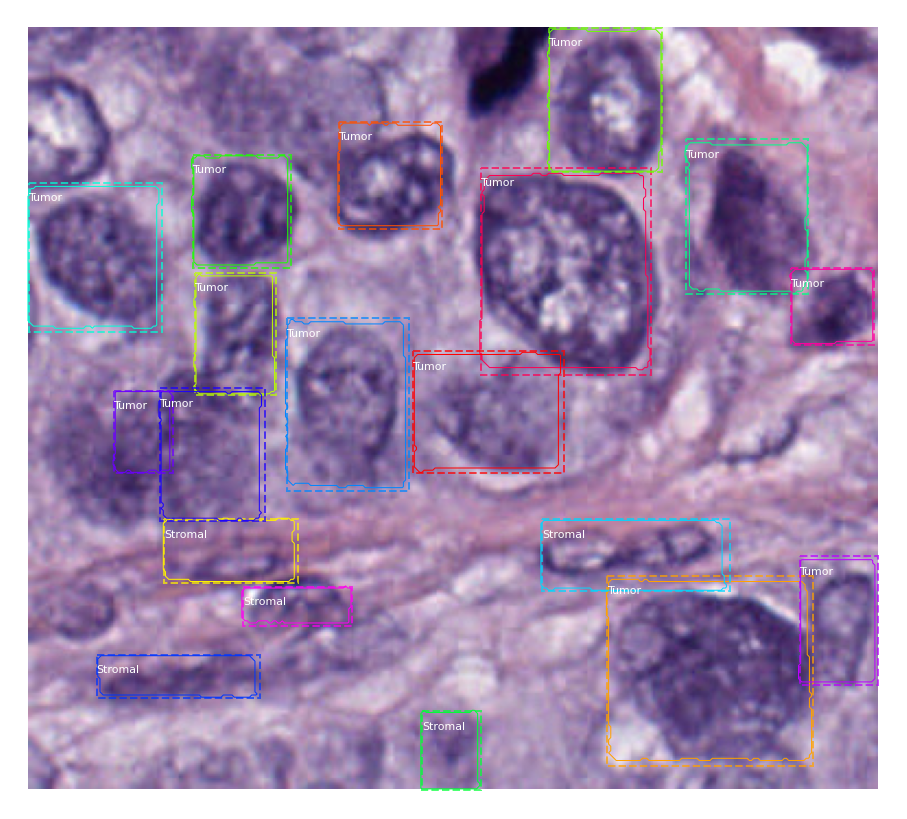

AP =  1.0
APs =  [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
mAP =  1.0


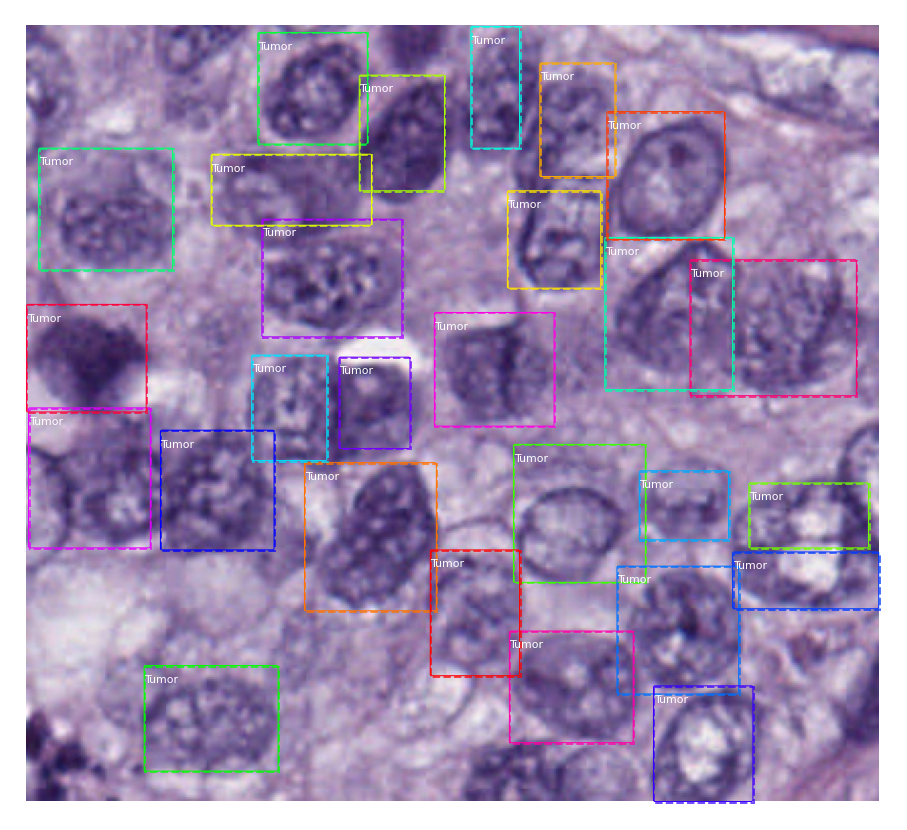

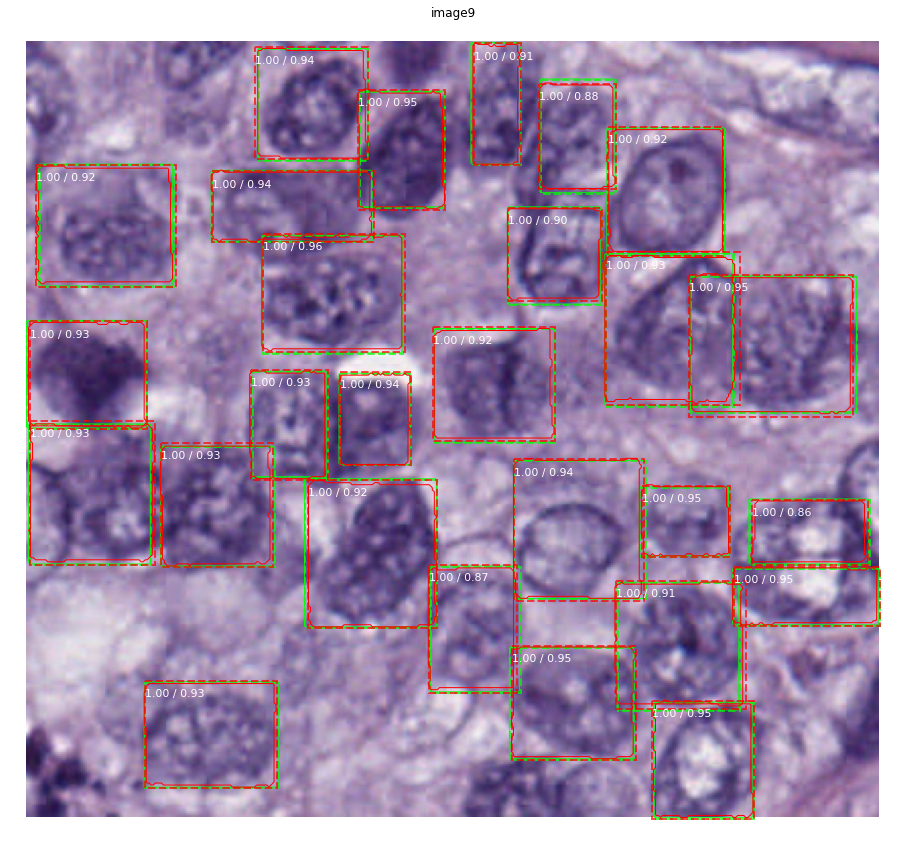

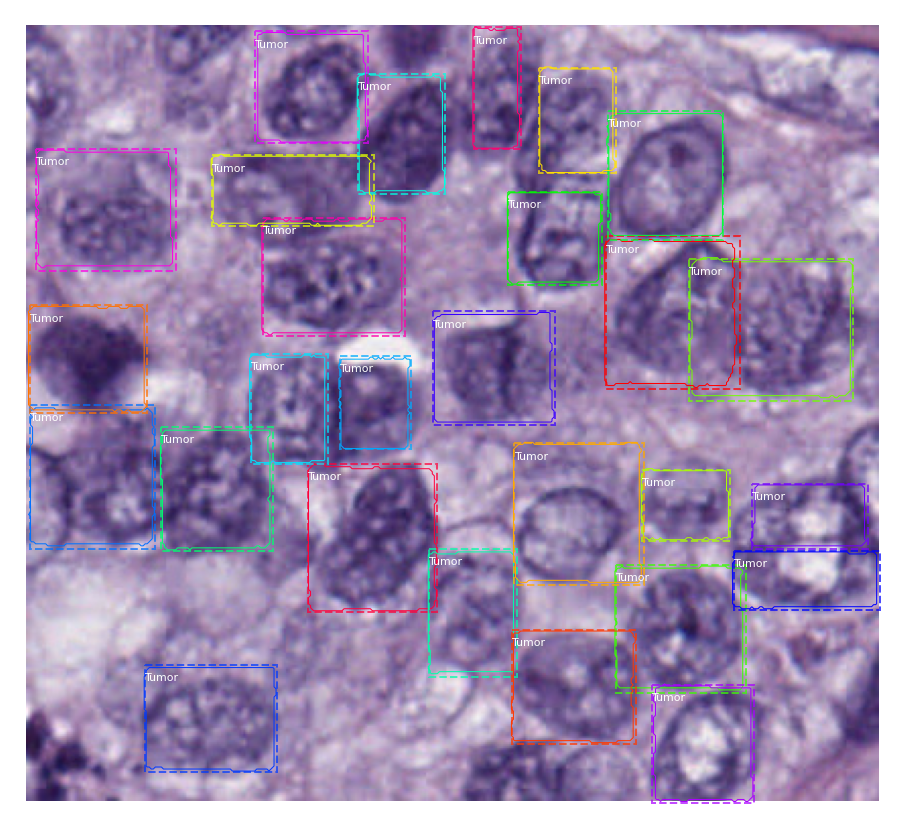

AP =  1.0
APs =  [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
mAP =  1.0


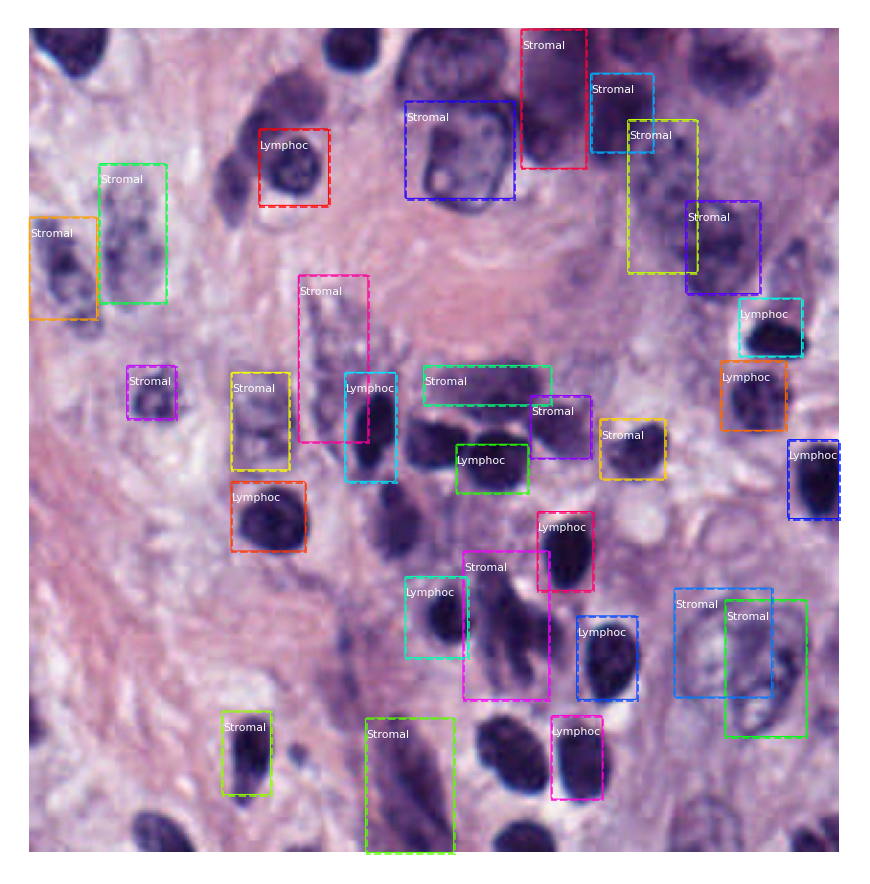

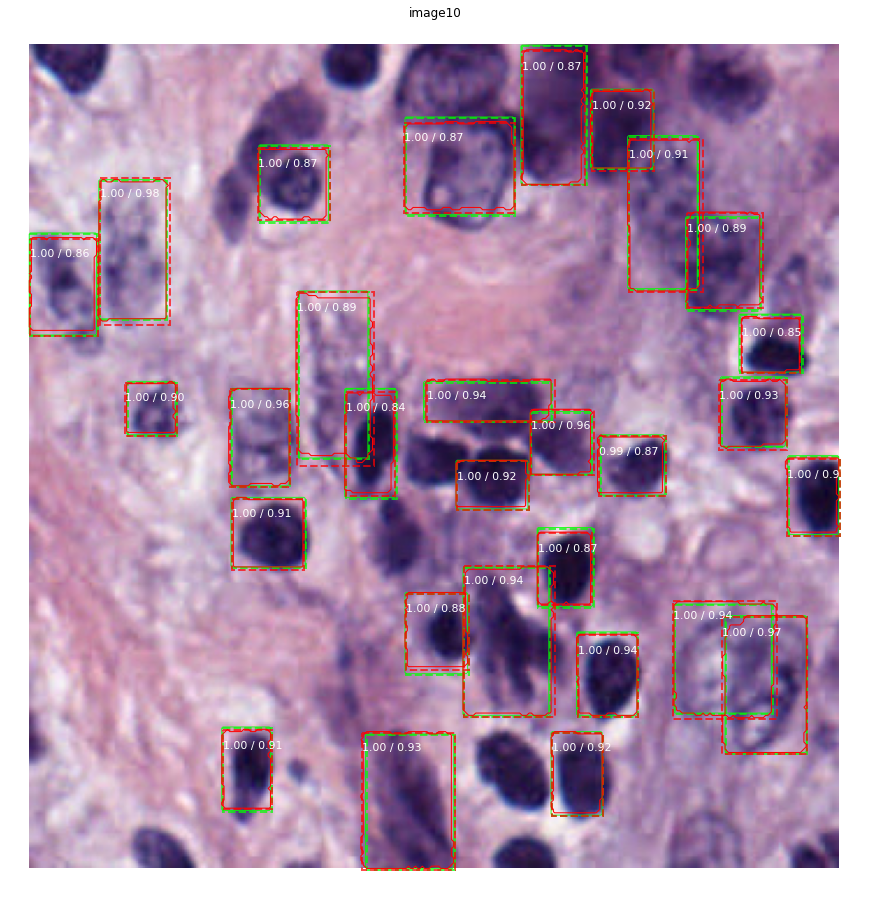

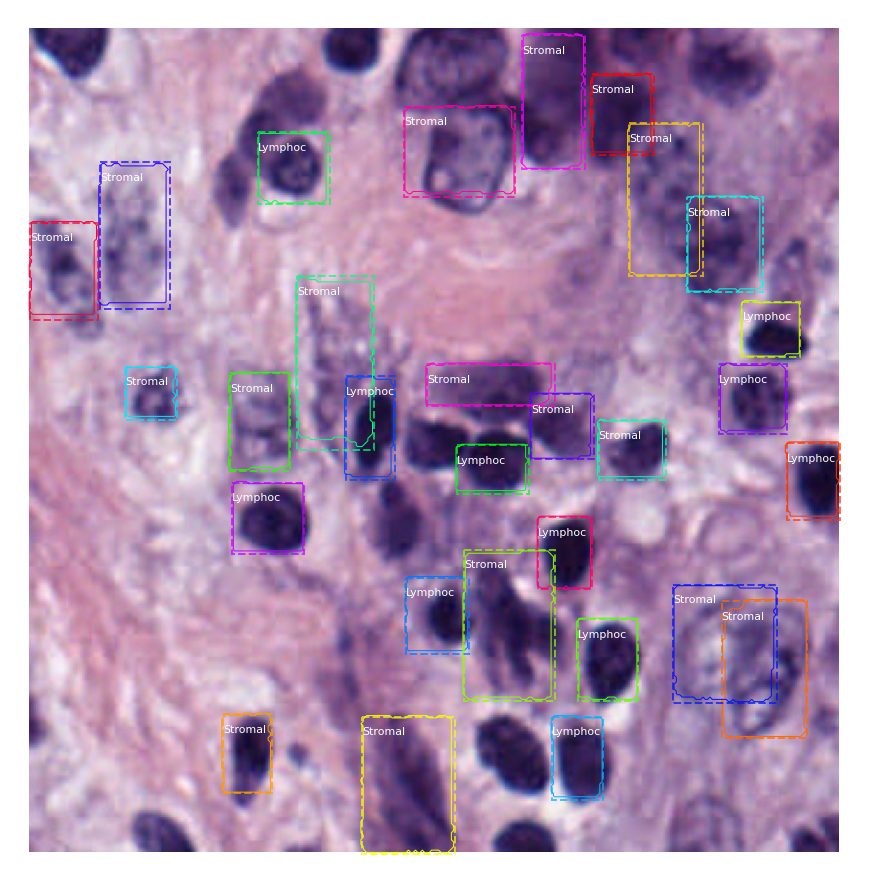

AP =  1.0
APs =  [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
mAP =  1.0


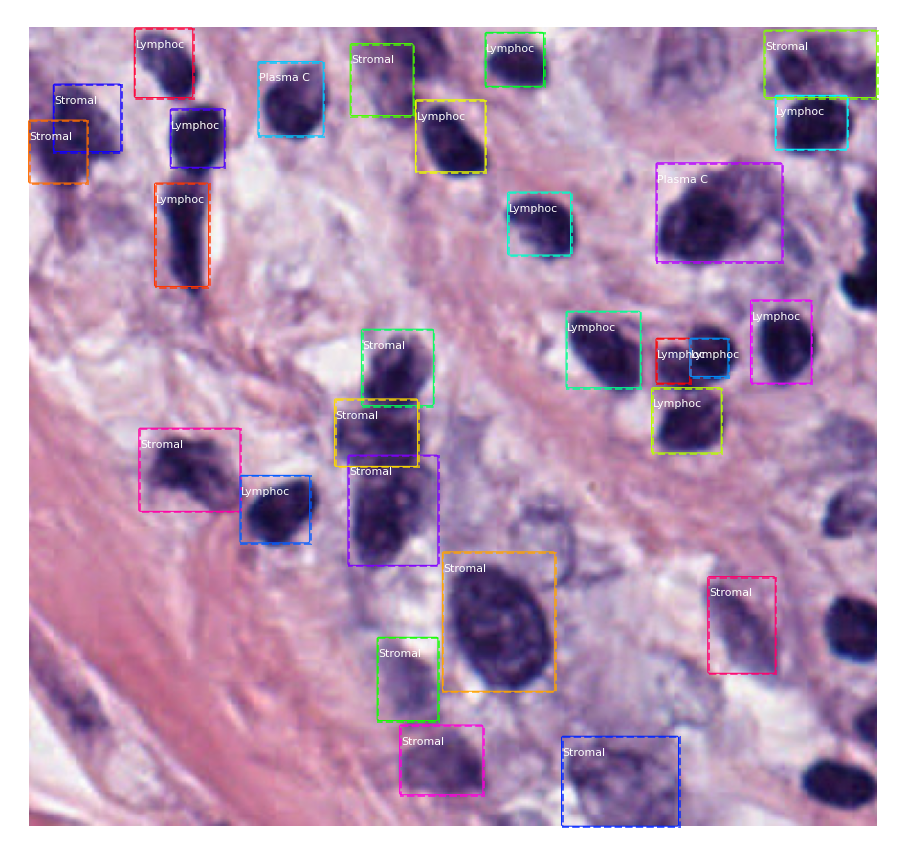

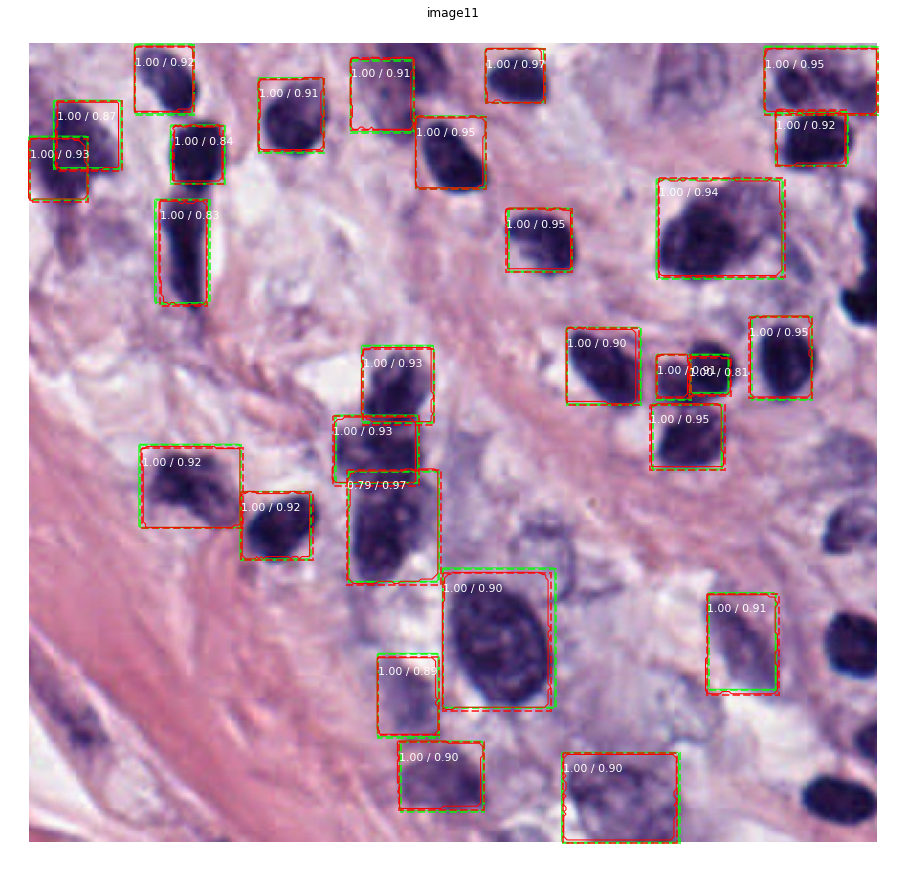

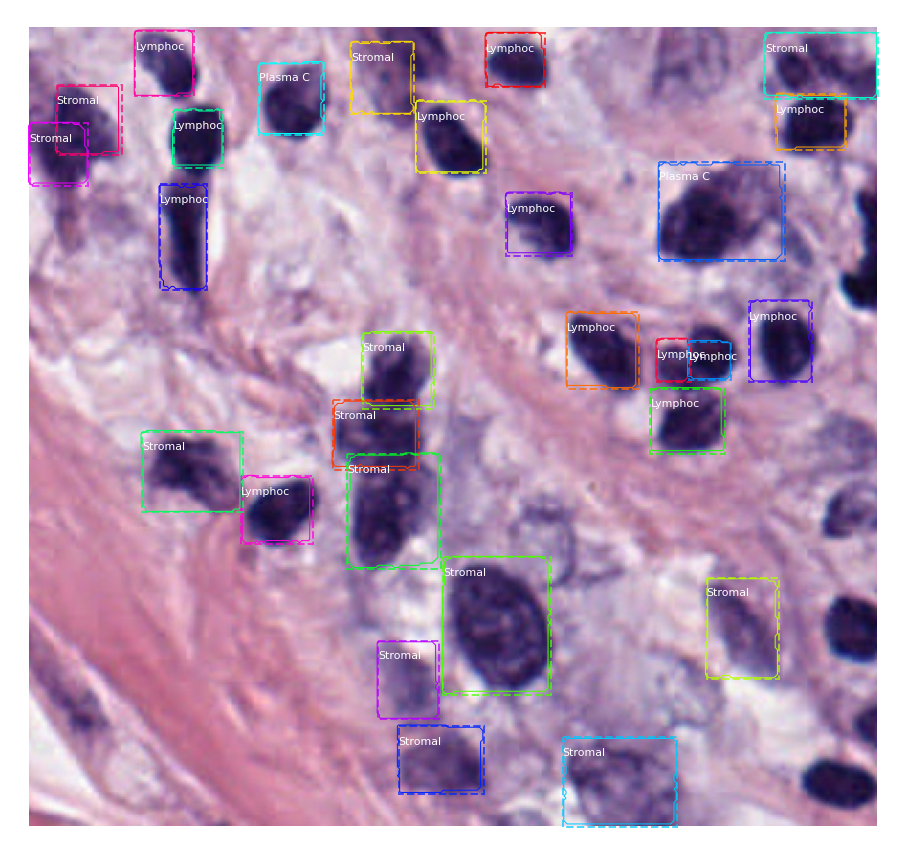

AP =  1.0
APs =  [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
mAP =  1.0


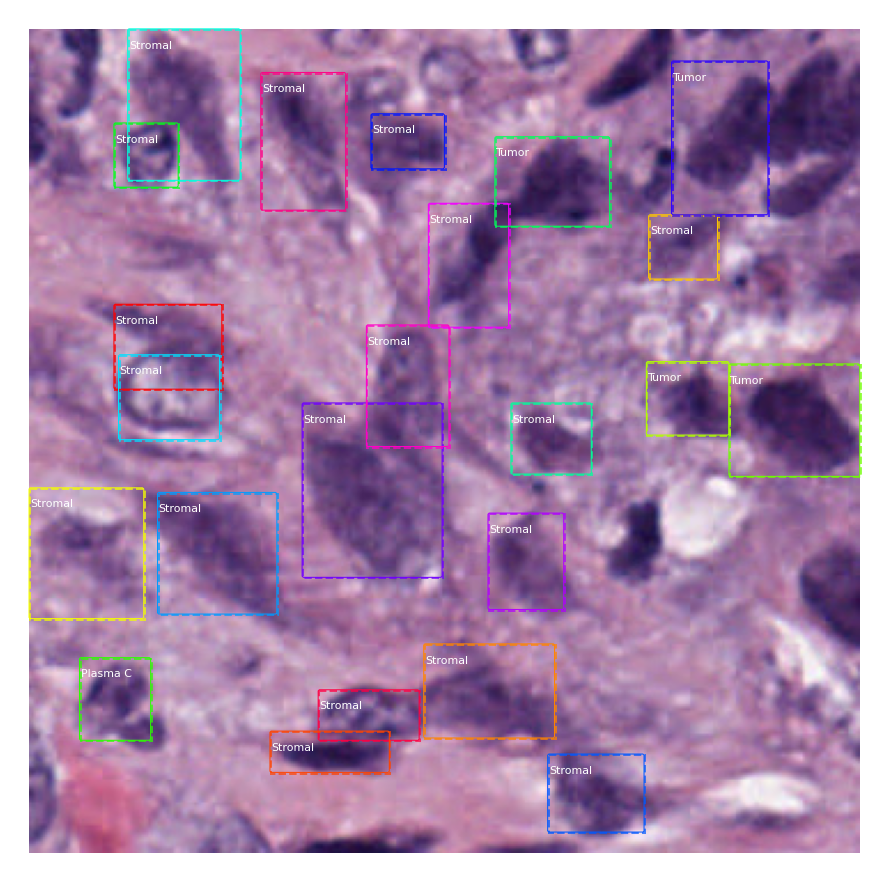

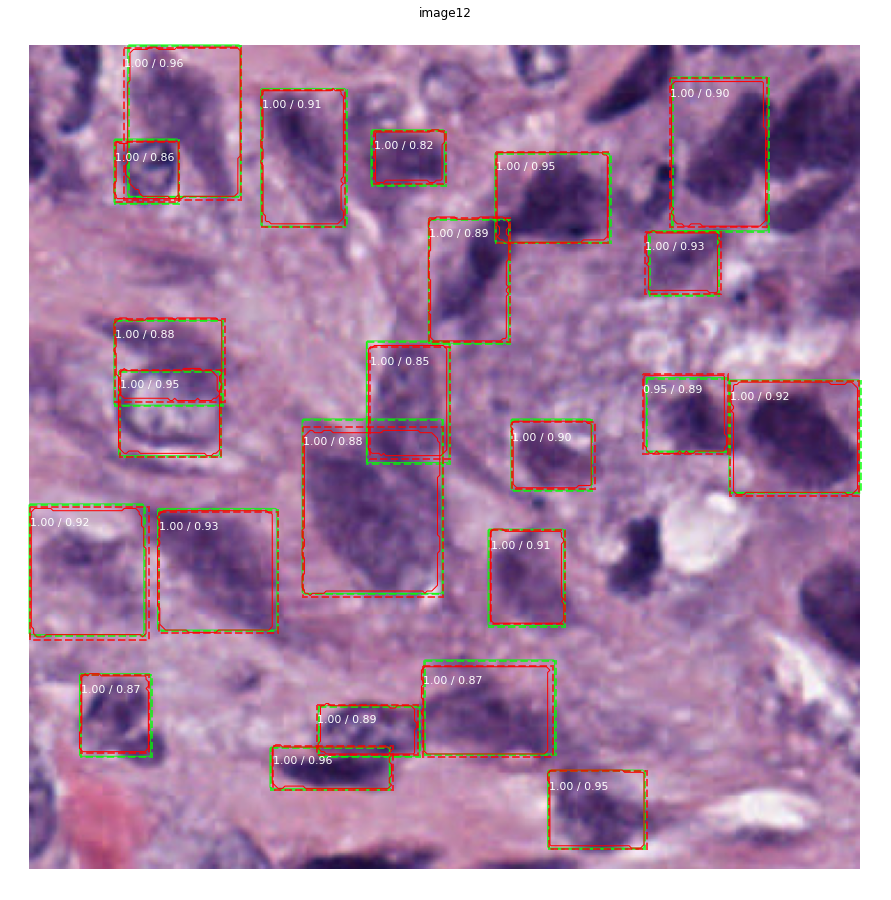

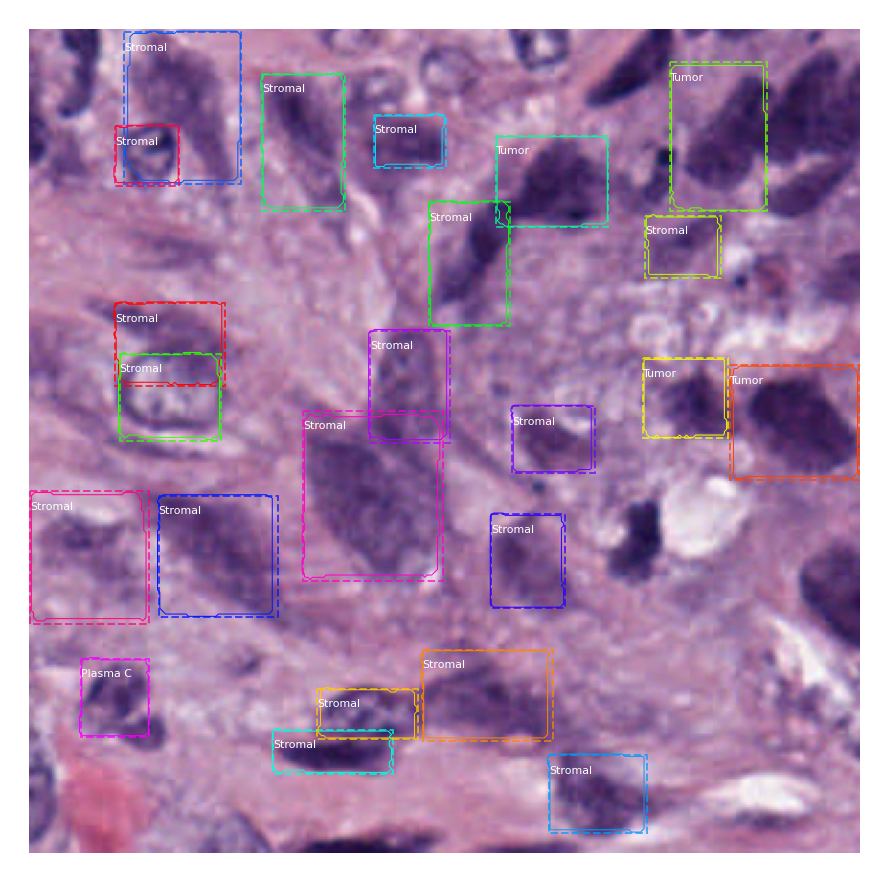

AP =  0.9599999785423279
APs =  [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.9599999785423279]
mAP =  0.9971428556101662


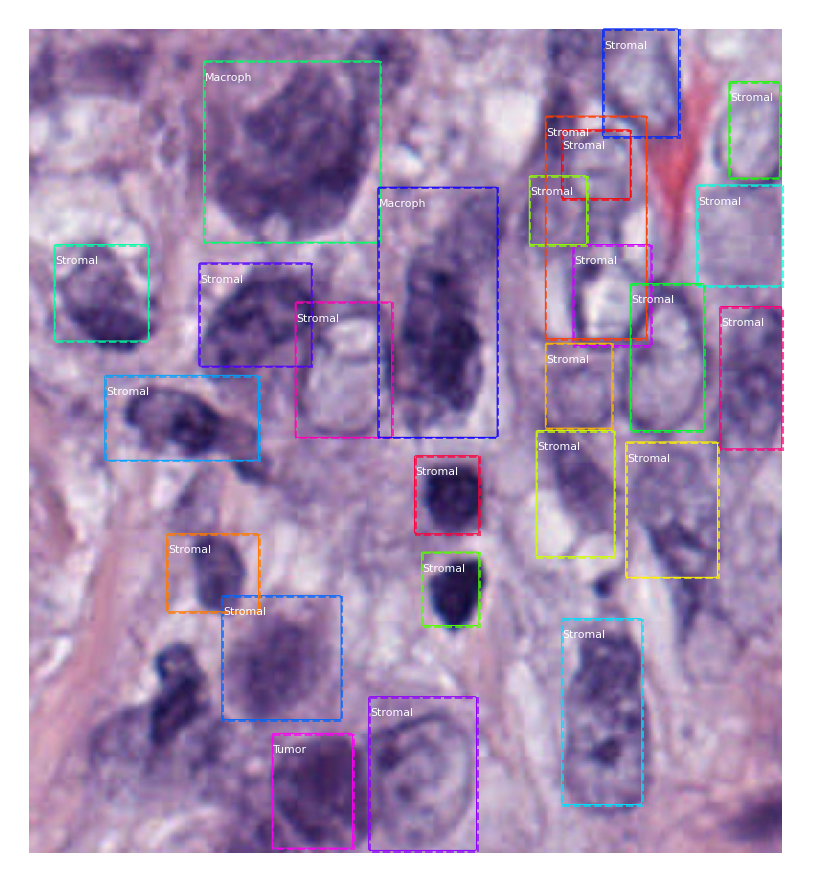

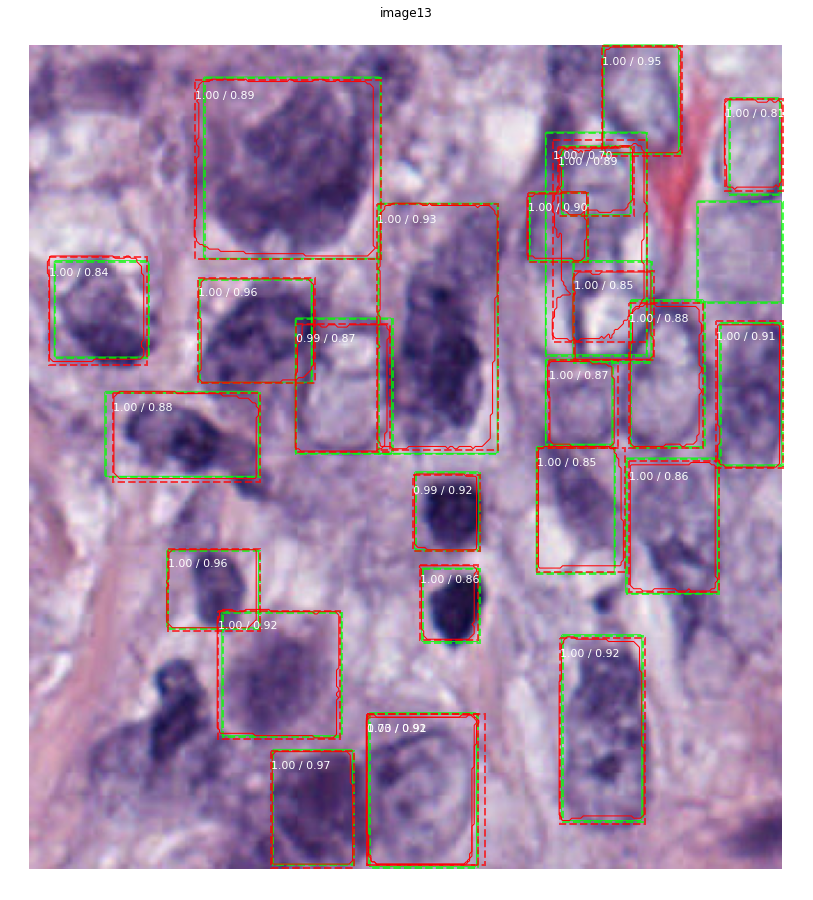

Buffered data was truncated after reaching the output size limit.

In [ ]:
plot_actual_vs_predicted(valid_dataset, model, Test_config, n_images=10)